# GG4257 - Urban Analytics: A Toolkit for Sustainable Urban Development
## Lab Workbook No 5: Intro to Networks
---
Dr Fernando Benitez -  University of St Andrews - School of Geography and Sustainable Development - Iteration 2024

> **GOOD ACADEMIC PRACTICE**: As always, The University policy on Good Academic Practice applies. There are probably many ways to address the challenges in here or part of them. You are free to do research and find relevant resources, like the documentation website, if you cited them correctly. But I strongly advise not to use AI tools, most importantly because you won't learn/practice as you are supposed to.
>
>  If you are not aware of **our academic misconduct policy**, kindly take a quick look (Pag 8. https://www.st-ndrews.ac.uk/policy/academic-policies-assessment-examination-and-award-good-academic-practice/good-academic-practice-guidance-for-students-frequently-asked-questions.pdf)


# Introduction to Networks

In this lab, you'll be introduced to fundamental concepts in network analytics while exploring a real-world network dataset. You'll also learn about [NetworkX][1], a library that allows you to manipulate, analyze, and model graph data ( the mathematical form of a network). You'll learn about the different types of graphs and how to visualize them rationally.


- Networks are a useful tool for modelling relationships between entities. Check the slides from Lecture 5 to see the main difference.
- By modelling the data as a network, you can gain insight into what entities (or nodes) are important.
- You can start to think about optimizing transportation between cities.
- Leverage the network structure to find communities in the network.

  [1]: https://networkx.github.io/documentation/stable/index.html

## Examples of Networks
1. Social:In a social network, we're modelling the relationship between people.

2. Mobility: In a transportation network, we're modelling the connectivity between locations as determined by the roads or flight paths connecting them.


## Network Structure

![image.png](https://github.com/trenton3983/DataCamp/blob/master/Images/2020-05-21_intro_to_network_analysis_in_python/network_structure_1.JPG?raw=true)

* Networks are described by two items, which form a "network":
 - Nodes
 - Edges
   
* In mathematical terms, this is a graph.
* Nodes and edges can have metadata associated with them.
 - Let's say two friends, Hugo and myself, met on May 21, 2016. The nodes may be "Hugo" and myself, with metadata stored in a `key-value` pair as `id` and `age`. The friendship is represented as a line between two nodes and may have metadata such as `date`, which represents the date we first met.
 
![social graph](https://github.com/trenton3983/DataCamp/blob/master/Images/2020-05-21_intro_to_network_analysis_in_python/network_structure_2.JPG?raw=true)


# NetworkX

>It is important you see how the data is being manipulated and you understand how the main methods in the library works, do not be afraid to change the code I provide in order to see what else you can or cant do. Make a copy of the original cell, then experiment.

This Python library is used to manipulate, analyze, and model graph data. Using `nx.Graph()`, we initialize an empty graph to which we can add nodes and edges.

Let's try adding nodes and edges, creating a graph from scratch:

- The integers 1, 2, and 3 can be entered as nodes using the `add_nodes_from` method, passing in the list `[1, 2, 3]` as an argument.
- Use the `.nodes` method to see the nodes present in the graph.
- Likewise, we can use `.add_edges` and `.edges` to add and see the edges present in the graph.
- Edges between nodes are represented as a **tuple**, in which each tuple shows the nodes that are present on that edge.

In [25]:
import warnings
warnings.simplefilter('ignore', DeprecationWarning)
warnings.filterwarnings('ignore')

In [2]:
#Uncomment the following line to install Networkx, in case you don't have it.
#pip install networkx

In [24]:
import networkx as nx

G = nx.Graph() #There are many other types of graphs; see Lecture 5 for more details.
G.add_nodes_from([1, 2, 3])
G.nodes()

NodeView((1, 2, 3))

In [4]:
G.add_edge(1, 2)
G.edges()

EdgeView([(1, 2)])

- Metadata (Information related to the network) can be stored on the graph as well.
- For example, I can add to the node `1`, a `label` key with the value `blue`, just as I would assign a value to the key of a python dictionary.
- The node list can be retrieved with `G.nodes()` and passing the `data=True` parameter.
- This returns a list of tuples (pairs), in which the first element of each tuple is the node, and the second element is a dictionary, in which the `key-value` pairs correspond to the metadata.

In [5]:
G.nodes[1]['label'] = 'blue'

G.nodes(data=True) #Try to add more metadata to the other nodes...

NodeDataView({1: {'label': 'blue'}, 2: {}, 3: {}})

We are used to seeing a Network by its common representation of nodes and edges, but by creating a graph from scratch, it is complicated to see how the network is and what they are connecting. Therefore, methods to draw graphs are always welcome. This can be very simple or very structured, depending on the type of draw we need, but we can start with the following:

- `networkx` provides basic drawing functionality, using the `nx.draw()` function, which uses a graph `G` as an argument.

- You'll also have to call `plt.show()` function to display the graph.

- With this graph, the `nx.draw()` function will draw to screen what we call a **node-link diagram** rendering of the graph.

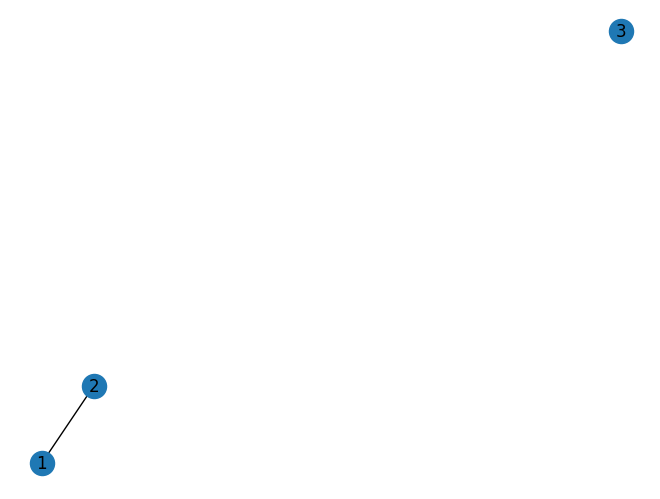

In [6]:
import matplotlib.pyplot as plt

nx.draw(G, with_labels=True )
plt.show()

## Use case: Twitter network

We will review some basic functions that let you query a Twitter network `T`. The Twitter data shows a snapshot of a subset of Twitter users. The network dataset is anonymized but includes some metadata.

The data was extracted from:

* twitter = https://assets.datacamp.com/production/repositories/580/datasets/64cf6963a7e8005e3771ef3b256812a5797320f0/ego-twitter.p

The data format used to store a network in Python is a binary file called a pickle file. This file stores a Python object. More info at https://docs.python.org/3/library/pickle.html

In [7]:
import pickle

with open('data/Lab5/network_analysis/ego-twitter.p', 'rb') as f:
    T = pickle.load(f)
T

Now, let's learn some very basic functions to explore the graph. 

In [8]:
print(len(T))# Tells you the size of the graph `T`, 
print(type(T.nodes())) # Tells you the type of `T.nodes()`
print(list(T.edges(data=True))[-1]) # Read the attributes associated with the last element of the edges list. 
print(list(T.nodes(data=True))[0]) # Read the attributes associated with the firts element of the node list.
print(type(list(T.edges(data=True))[-1][2])) # Wich type; therefore, you can see what you are reading.

23369
<class 'networkx.classes.reportviews.NodeView'>
(23324, 23336, {'date': datetime.date(2010, 9, 20)})
(1, {'category': 'I', 'occupation': 'politician'})
<class 'dict'>


The attributes associated with the `nodes` and the `edges` are `**category**`, `**ocupation**` for `nodes` and `**date**` for `edges`

## Queries on a network

After learning about some fundamental properties of the graph and practising its visualization using NetworkX's drawing tools, it's time to learn how to query nodes and edges. This involves searching for "nodes of interest" and "edges of interest".

You'll use the `.nodes()` and `.edges()` methods. The `.nodes()` method returns a list of nodes, while the `.edges()` method returns a list of tuples, in which each tuple shows the nodes that are present on that edge. 

There is a keyword argument `data=True` in these methods that also retrieves the corresponding metadata associated with the nodes and edges. 

You can examine other graph's properties like `T.adj` and `T.degree`. These are set-like views of the neighbours (adjacencies), and degrees of nodes in a graph.[1]

[1]: https://networkx.org/documentation/stable/tutorial.html#examining-elements-of-a-graph

In [9]:
T.number_of_nodes()

23369

In [10]:
#list(T.degree)
#list(T.adj)
#list(T.edges)
#list(T.nodes) # Be aware you will get a massive list; recall the size of the network "23369"
# So we need a subset of that to make the exploration easier.

As the network is massive, we can make a subset by specifying only the node we want. This makes a use of something call `nbunch` to filter only nodes within the defined network

https://networkx.org/documentation/stable/reference/glossary.html#term-nbunch

In [11]:
edges_from_T=T.edges([36,1,75])
#edges_from_T=T.edges([36,1,75], data=True) #Give the edges where only 36, 1 and 75 are nodes.
edges_from_T

OutEdgeDataView([(36, 5), (36, 4390), (36, 18570), (36, 1307), (36, 18571), (36, 24), (36, 35), (36, 4452), (36, 12613), (36, 37), (36, 1325), (1, 3), (1, 4), (1, 5), (1, 6), (1, 7), (1, 8), (1, 9), (1, 10), (1, 11), (1, 12), (1, 13), (1, 14), (1, 15), (1, 16), (1, 17), (1, 18), (1, 19), (1, 20), (1, 21), (1, 22), (1, 23), (1, 24), (1, 25), (1, 26), (1, 27), (1, 28), (1, 29), (1, 30), (1, 31), (1, 32), (1, 33), (1, 34), (1, 35), (1, 36), (1, 37), (1, 38), (1, 39), (1, 40), (1, 41), (1, 42), (1, 43), (1, 44), (1, 45), (1, 46), (1, 47), (1, 48), (1, 49), (75, 63), (75, 64), (75, 65), (75, 66), (75, 6627), (75, 2124), (75, 67), (75, 6629), (75, 6631), (75, 6632), (75, 879), (75, 6634), (75, 6624), (75, 69), (75, 6637), (75, 6638), (75, 6639), (75, 70), (75, 6641), (75, 6643), (75, 6644), (75, 71), (75, 6646), (75, 6648), (75, 72), (75, 73), (75, 6652), (75, 6655), (75, 82), (75, 74), (75, 10969), (75, 6656), (75, 6657), (75, 6658), (75, 76), (75, 83), (75, 6666), (75, 6677), (75, 78)])

We later create an empty graph.

In [12]:
T_sub = nx.DiGraph()
len(T_sub)

0

In [13]:
T_sub.add_edges_from(edges_from_T) #Adding the list from the subset of nodes.
len(T_sub)

95

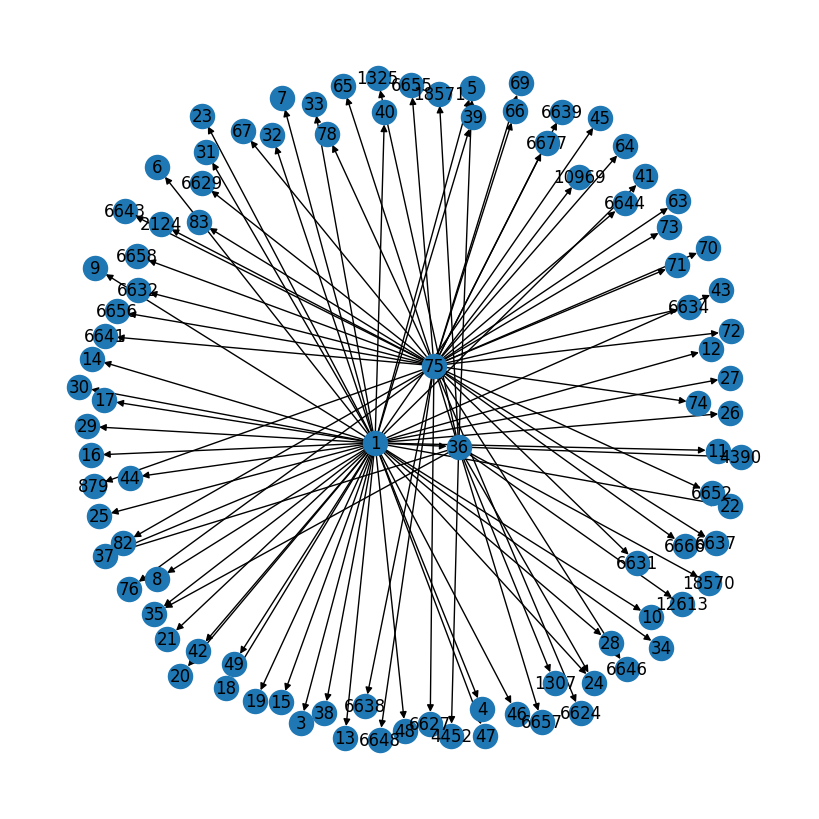

In [14]:
plt.figure(figsize=(8, 8))
nx.draw(T_sub, with_labels=True)
plt.show()

## List comprehensions

So far, you have been working using traditional loops that iterate over iterable objects like lists, arrays or data frames. However, that often isn't the most effective way to iterate over an object with multiple items. We can use `list comprehensions` to iterate over Python objects effectively and build queries in one line, rather than a loop that usually involves `.append` methods.  For a detailed  description of list comprehensions, refer to [2] of DataCamp's Python Data Science Toolbox course. 

If you want to create a list comprehension, here is a recipe for it:

> `[` *output expression* `for` *iterator variable* `in` *iterable* `if` *predicate expression* `]`.

For example, if your task is to get a **list of nodes** from the graph `T` with the `'occupation'` label of `'scientist'`. You need to loop over the list of nodes (`T.nodes(data=True)`, including the metadata), and then get each value in the list, but only under the conditions that the `occupation` attribute is equal to `scientist`

So traditionally, you will be asked to make an empty list, then a For loop, and then use the append to get all the values in the empty list appended.

```python
noi = []
for n, a in T.nodes(data=True): # where a is the attribute we need to filter, and n the nodes.
    if a['occupation'] == 'scientist':
        noi.append(n)
    
````
Instead of using four lines of code, we can use list comprehensions in the following way: 

```python
# Use a list comprehension to get the nodes of interest: noi
noi = [n for n, a in T.nodes(data=True) if a['occupation'] == 'scientist']
```
Now, it's the same process for the **edges of interest -eoi**; in this case, you are iterating over a tuple, so you need one extra argument. Traditionally, you will have to:

```python
eoi = []
for u, v, d in T.edges(data=True): #where u, v are the nodes conforming the edge. and d the attribute associated with date
    if d['date'].year < 2010:
        eoi.append((u, v))
````
But a more effective code would be:

```python
# Use a list comprehension to get the edges of interest: eoi
eoi = [(u, v) for u, v, d in T.edges(data=True) if d['date'].year < 2010]
```

[2]: https://www.datacamp.com/courses/python-data-science-toolbox-part-2


In [15]:
noi = [n for n, a in T.nodes(data=True) if a['occupation'] == 'scientist']
eoi = [(u, v) for u, v, d in T.edges(data=True) if d['date'].year < 2010]

In [16]:
print(noi[:10])
print(eoi[:10])

[5, 9, 13, 15, 17, 19, 20, 22, 23, 27]
[(1, 5), (1, 9), (1, 13), (1, 15), (1, 16), (1, 17), (1, 18), (1, 19), (1, 24), (1, 27)]


# Types of Graphs/Networks

See the Lecture No 5 for more detailed information.

1. **Undirected graphs**
 - e.g. Facebook, when one user befriends another, the two are automatically connected with an edge.
 - They are comprised of edges that don't have any inherent directionality associated with them.
 - This is commonly drawn as a line with no arrows between two circles.
 - Undirected graphs have the type `Graph`
 
```python
import networkx as nx

G = nx.Graph()
type(G)
>>> networkx.classes.graph.Graph
``` 


2. **Directed graphs**
 - e.g. Twitter, one user may follow another, but that other user may not follow back.
 - This is because of the nature of how users interact with one another.
 - As such, there's an inherent directionality associated with the graph
 - Directed grasphs have the type `DiGraph`
 
```python
D = nx.DiGraph()
type(D)
>>> networkx.classes.digraph.DiGraph
```

3. **Muti-edge (Directed) graphs**
   
 - Graph in which there are multiple edges permitted between the nodes
 - For example, we may want to model trips between bike-sharing stations
 - Each trip may be one edge between the pair of stations
 - Sometimes, for practical reasons, it may be too memory-intensive to model multiple edges per pair of nodes. So, one may choose to collapse the edges into a single edge that contains a metadata summary of the original.
 - For example, we may want to collapse these three edges into a single one and give them a _weight_ metadata with the value _3_, indicating that it was originally three edges between the pair of nodes.

![multi-edge][1]

```python
M = nx.MultiGraph
type(M)
>>> networkx.classes.multigraph.MultiGraph

MD = nx.MultiDiGraph
type(MD)
>>> networkx.classes.multidigraph.MultiDiGraph
```

4. **Self-loops**: Self-loops can be used in certain scenarios, such as in bike sharing data, where a trip begins at a station and ends at the same station.


[1]: https://raw.githubusercontent.com/trenton3983/DataCamp/master/Images/2020-05-21_intro_to_network_analysis_in_python/multi-edge.JPG

## Self-loops

NetworkX also allows edges that begin and end on the same node; while this would be non-intuitive for a social network graph, it is useful to model data such as trip networks, where individuals begin at one location and end in another.

It is useful to check for this before proceeding with further analyses, and NetworkX graphs provide a method for this purpose: `.number_of_selfloops()`

Here we use the `.number_of_selfloops()` method on `T` to get the number of edges that begin and end on the same node. 

In [17]:
nx.number_of_selfloops(T)

42

## Specifying a weight on edges

Weights can be added to edges in a graph, typically indicating the _strength_ of an edge. In NetworkX, the weight is indicated by the `'weight'` key in the metadata dictionary.

Refer to the following template to set an attribute of an edge: `network_name.edges[node1, node2]['attribute'] = value`. Here, the `'attribute'` is `'weight'`.

- If we want to set the `'weight'` attribute of the edge between node `1` and `10` of `T` to be equal to `2`.
  We could just `T.edges[1, 10]['weight'] = 2`
- If we want to set the weight of every edge involving node `293` to be equal to `1.1`.
  We can use a `for` loop and iterate over all the edges of `T`, including the `metadata`. If `293` is involved in the list of nodes `[u, v]`, we set the weight of the edge between `u` and `v` to be `1.1`.

In [18]:
T.edges[1, 10] #See that you only have one category.

{'date': datetime.date(2012, 9, 8)}

In [19]:
# Set the weight of the edge
T.edges[1, 10]['weight'] = 2
T.edges[1, 10] # Now you have two categories

{'date': datetime.date(2012, 9, 8), 'weight': 2}

In [20]:
for u, v, d in T.edges(data=True):

    # Check if node 293 is involved
    if 293 in [u, v]:

        # Set the weight to 1.1
        T.edges[u, v]['weight'] = 1.1

In [21]:
#pip install nxviz
#Uncomment the previous line in case you don't have nxviz

## Plotting networks

1. **Matrix plots**: Nodes are the rows and columns of a matrix, and cells are filled in according to whether an edge exists between the pairs of nodes.

   ![image](https://raw.githubusercontent.com/trenton3983/DataCamp/master/Images/2020-05-21_intro_to_network_analysis_in_python/matrix_plots.JPG)

In an undirected graph, the matrix is symmetrical around the diagonal, which is highlighted in grey.
* Figure 3: edge (A, B) is equivalent to edge (B, A).  Highlighted in yellow.
* Figure 4: edge (A, C) is equivalent to edge (C, A), because there's no directionality associated with that edge.
  
- With directed graphs, the matrix representation is not necessarily going to be symmetrical.
  * Figure 5: there's a bidirectional edge between A and C, but only an edge from A to B and not B to A.
  * (A, B) will be filled in, but not (B, A)

- If the nodes are ordered along the rows and columns, such that neighbours are listed close to one another, then a matrix plot can be used to visualise clusters, or communities, of nodes.

2. **Arc plots**
 - ![arc_plots][2]
 -  Is it a transformation of the node-link diagram layout, in which nodes are ordered along one axis of the plot, and edges are drawn using circular arcs from one node to another
 - If the nodes are ordered according to some sortable rule, such as age in a social network of users, or otherwise grouped together by geographic location in a map for a transportation network, then it will be possible to visualise the relationship between connectivity and the sorted (or grouped) property.
  - Arc plots are a good starting point for visualizing a network, as they form the basis of the later plots that we'll take a look at.
   
3. **Circos plots**
 - ![circo_plot][3]
 - It is a transformation of the Arc Plot, such that two ends of the Arc Plot are joined together into a circle.
 - Were originally designed for use in genomics, and you can think of them as an aesthetic and compact alternative to Arc Plots.
- You will be using [nxviz][4] to plot the graphs.

  [2]: https://raw.githubusercontent.com/trenton3983/DataCamp/master/Images/2020-05-21_intro_to_network_analysis_in_python/arc_plots.JPG
  [3]: https://raw.githubusercontent.com/trenton3983/DataCamp/master/Images/2020-05-21_intro_to_network_analysis_in_python/circo_plots.JPG
  [4]: https://github.com/ericmjl/nxviz

Now lets see how we can plot these types of graphs using an additional library, `nxviz`, which is a package for visualizing graphs in a rational fashion; under the hood, the `MatrixPlo`t utilizes `nx.to_numpy_matrix(G)`, which returns the matrix form of the graph. 

See more in: https://nxviz.readthedocs.io/en/latest/usage.html

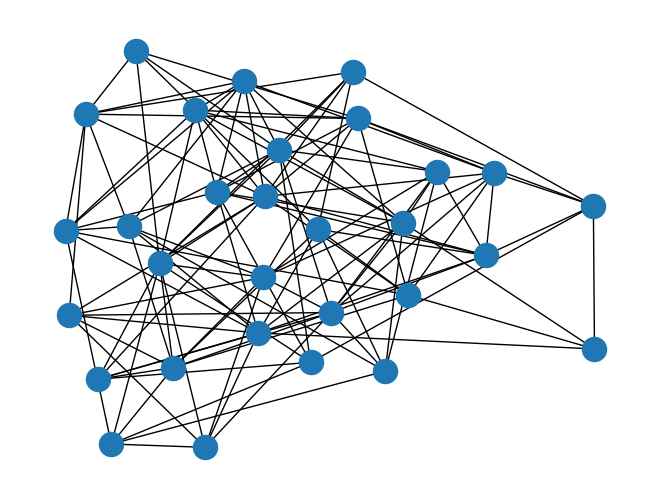

In [22]:
#Basic plot of a graph

import networkx as nx
import matplotlib.pyplot as plt

er = nx.erdos_renyi_graph(30, 0.3)
nx.draw(er)
plt.show()

In [23]:
# Now, let's create a synthetic network to make several plots.
import nxviz as nv
from datetime import datetime, date

data = [(13829, 1386, {'date': date(2012, 3, 13)}), (3086, 669, {'date': date(2009, 3, 1)}), (3086, 3100, {'date': date(2013, 8, 10)}), (3086, 3117, {'date': date(2007, 12, 20)}), (4111, 4133, {'date': date(2007, 10, 28)}), (4111, 12582, {'date': date(2013, 6, 1)}), (6163, 7331, {'date': date(2013, 2, 3)}), (6163, 7336, {'date': date(2007, 9, 12)}), (6163, 6168, {'date': date(2008, 4, 2)}), (6163, 1326, {'date': date(2009, 2, 16)}), (4636, 4666, {'date': date(2012, 3, 20)}), (543, 12123, {'date': date(2014, 8, 12)}), (36, 24, {'date': date(2009, 4, 23)}), (12836, 12856, {'date': date(2014, 2, 21)}), (10790, 10854, {'date': date(2009, 8, 11)}), (9262, 9338, {'date': date(2007, 11, 11)}), (4160, 4161, {'date': date(2012, 4, 14)}), (4160, 3681, {'date': date(2013, 8, 10)}), (7746, 3396, {'date': date(2007, 2, 23)}), (7746, 543, {'date': date(2011, 7, 14)}), (7746, 5073, {'date': date(2012, 2, 25)}), (7746, 1130, {'date': date(2013, 8, 4)}), (7746, 3265, {'date': date(2008, 11, 8)}), (19013, 21248, {'date': date(2009, 3, 21)}), (19013, 21253, {'date': date(2007, 8, 17)}), (14916, 14930, {'date': date(2012, 4, 10)}), (5717, 5752, {'date': date(2009, 2, 2)}), (3159, 3176, {'date': date(2011, 8, 15)}), (3159, 3177, {'date': date(2008, 2, 1)}), (3159, 3193, {'date': date(2014, 1, 2)}), (1627, 1648, {'date': date(2011, 11, 7)}), (19550, 19570, {'date': date(2009, 11, 13)}), (5215, 5217, {'date': date(2011, 1, 7)}), (4198, 16203, {'date': date(2014, 12, 1)}), (3177, 3159, {'date': date(2010, 6, 2)}), (3177, 3176, {'date': date(2014, 11, 10)}), (1134, 2406, {'date': date(2011, 7, 10)}), (1134, 543, {'date': date(2011, 10, 20)}), (4206, 21962, {'date': date(2014, 4, 17)}), (6770, 2671, {'date': date(2010, 5, 18)}), (11384, 4955, {'date': date(2007, 2, 12)}), (11384, 2406, {'date': date(2007, 10, 13)}), (11384, 11402, {'date': date(2009, 11, 27)}), (10877, 10917, {'date': date(2014, 7, 17)}), (10877, 7886, {'date': date(2009, 1, 4)}), (10877, 36, {'date': date(2008, 10, 25)}), (10877, 10936, {'date': date(2008, 12, 26)}), (10877, 1326, {'date': date(2012, 1, 19)}), (10373, 1386, {'date': date(2011, 4, 21)}), (10373, 2501, {'date': date(2012, 8, 13)}), (3213, 3214, {'date': date(2008, 4, 19)}), (3213, 3265, {'date': date(2007, 8, 8)}), (3213, 3266, {'date': date(2009, 1, 4)}), (5626, 16654, {'date': date(2011, 3, 5)}), (20122, 20177, {'date': date(2014, 12, 21)}), (667, 669, {'date': date(2014, 2, 3)}), (667, 747, {'date': date(2008, 2, 23)}), (161, 18159, {'date': date(2014, 9, 22)}), (7331, 6163, {'date': date(2012, 10, 15)}), (7331, 6168, {'date': date(2012, 3, 17)}), (7331, 7606, {'date': date(2008, 11, 7)}), (7331, 24, {'date': date(2009, 9, 21)}), (7331, 36, {'date': date(2010, 5, 26)}), (10917, 10877, {'date': date(2011, 9, 7)}), (10917, 24, {'date': date(2014, 10, 16)}), (10917, 7886, {'date': date(2011, 7, 13)}), (10917, 36, {'date': date(2013, 8, 8)}), (10917, 1326, {'date': date(2009, 5, 23)}), (22184, 22188, {'date': date(2012, 11, 3)}), (6318, 6301, {'date': date(2011, 4, 3)}), (8367, 8421, {'date': date(2012, 7, 10)}), (21167, 3931, {'date': date(2012, 7, 9)}), (3265, 4955, {'date': date(2012, 6, 6)}), (3265, 4811, {'date': date(2014, 9, 18)}), (3265, 3266, {'date': date(2008, 9, 24)}), (3266, 4811, {'date': date(2007, 2, 16)}), (3266, 1926, {'date': date(2008, 3, 16)}), (3266, 3265, {'date': date(2014, 5, 25)}), (4291, 4306, {'date': date(2014, 9, 9)}), (4291, 4310, {'date': date(2007, 9, 11)}), (4811, 4955, {'date': date(2007, 4, 19)}), (4811, 3265, {'date': date(2013, 8, 23)}), (4811, 3266, {'date': date(2008, 8, 25)}), (7886, 10877, {'date': date(2012, 9, 5)}), (7886, 10917, {'date': date(2008, 9, 19)}), (7886, 24, {'date': date(2014, 8, 17)}), (7886, 36, {'date': date(2012, 9, 21)}), (7886, 1326, {'date': date(2012, 3, 23)}), (6863, 14981, {'date': date(2012, 8, 7)}), (13012, 13017, {'date': date(2012, 3, 4)}), (16597, 24, {'date': date(2012, 5, 2)}), (16597, 36, {'date': date(2011, 4, 19)}), (16597, 16610, {'date': date(2011, 11, 11)}), (12507, 12523, {'date': date(2012, 3, 11)}), (16618, 16619, {'date': date(2013, 3, 3)}), (13036, 15161, {'date': date(2012, 4, 23)}), (3826, 669, {'date': date(2014, 11, 9)}), (3826, 3100, {'date': date(2009, 2, 24)}), (3826, 3860, {'date': date(2013, 7, 27)}), (3826, 3681, {'date': date(2013, 2, 14)}), (7410, 7437, {'date': date(2012, 5, 2)}), (15092, 2148, {'date': date(2014, 11, 11)}), (15092, 20816, {'date': date(2009, 4, 8)}), (2820, 2826, {'date': date(2011, 10, 1)}), (2820, 2871, {'date': date(2010, 3, 26)}), (2311, 2371, {'date': date(2008, 8, 26)}), (11020, 11042, {'date': date(2008, 5, 12)}), (13070, 13079, {'date': date(2009, 10, 15)}), (20755, 24, {'date': date(2010, 11, 26)}), (20755, 1326, {'date': date(2014, 5, 2)}), (20756, 669, {'date': date(2012, 9, 7)}), (20756, 3100, {'date': date(2013, 3, 17)}), (20756, 3681, {'date': date(2010, 12, 9)}), (14613, 14617, {'date': date(2009, 6, 2)}), (10004, 10030, {'date': date(2008, 3, 1)}), (10004, 10111, {'date': date(2011, 7, 15)}), (4892, 1130, {'date': date(2011, 12, 10)}), (4892, 4947, {'date': date(2012, 3, 6)}), (2871, 15372, {'date': date(2014, 4, 27)}), (6968, 669, {'date': date(2010, 2, 6)}), (6968, 1386, {'date': date(2012, 9, 20)}), (6968, 4133, {'date': date(2012, 9, 22)}), (3385, 3396, {'date': date(2008, 3, 4)}), (8001, 23190, {'date': date(2008, 6, 26)}), (19787, 13581, {'date': date(2012, 4, 3)}), (21325, 21371, {'date': date(2009, 8, 2)}), (16720, 16734, {'date': date(2007, 10, 26)}), (16720, 16739, {'date': date(2008, 10, 24)}), (12119, 24, {'date': date(2013, 6, 1)}), (12119, 36, {'date': date(2007, 5, 1)}), (22872, 22918, {'date': date(2014, 7, 15)}), (7519, 16041, {'date': date(2012, 7, 8)}), (12640, 18082, {'date': date(2007, 4, 20)}), (12640, 18086, {'date': date(2008, 7, 8)}), (5987, 4957, {'date': date(2010, 12, 4)}), (5987, 492, {'date': date(2009, 6, 25)}), (19316, 19344, {'date': date(2013, 3, 15)}), (19316, 2501, {'date': date(2011, 11, 15)}), (13690, 4955, {'date': date(2014, 4, 5)}), (12162, 15560, {'date': date(2011, 1, 4)}), (2443, 3564, {'date': date(2014, 1, 9)}), (401, 492, {'date': date(2010, 11, 25)}), (401, 502, {'date': date(2013, 6, 27)}), (9106, 9107, {'date': date(2012, 5, 4)}), (8598, 8616, {'date': date(2011, 2, 6)}), (21919, 4161, {'date': date(2007, 7, 18)}), (21919, 669, {'date': date(2011, 12, 12)}), (21919, 3100, {'date': date(2012, 10, 15)}), (21919, 3681, {'date': date(2011, 1, 14)}), (10143, 4306, {'date': date(2009, 5, 26)}), (4517, 6414, {'date': date(2008, 7, 15)}), (20906, 2406, {'date': date(2012, 9, 5)}), (20906, 492, {'date': date(2013, 8, 12)}), (6059, 20368, {'date': date(2008, 11, 20)}), (2501, 1386, {'date': date(2009, 5, 1)}), (2501, 10373, {'date': date(2012, 7, 15)}), (13257, 13286, {'date': date(2008, 11, 4)}), (1484, 1492, {'date': date(2008, 6, 5)}), (1484, 1499, {'date': date(2013, 8, 9)}), (1996, 6038, {'date': date(2012, 7, 28)}), (20947, 669, {'date': date(2011, 7, 19)}), (20947, 3100, {'date': date(2010, 11, 23)}), (20947, 3681, {'date': date(2008, 6, 20)}), (5590, 5601, {'date': date(2012, 8, 17)}), (5590, 5626, {'date': date(2013, 8, 18)}), (18917, 19012, {'date': date(2013, 12, 15)}), (18917, 19013, {'date': date(2014, 1, 17)}), (10730, 24, {'date': date(2010, 1, 21)}), (10730, 36, {'date': date(2014, 1, 11)}), (10730, 1326, {'date': date(2008, 11, 4)}), (23024, 669, {'date': date(2010, 6, 15)}), (23024, 3100, {'date': date(2012, 6, 1)}), (23024, 23091, {'date': date(2011, 5, 20)}), (5109, 5112, {'date': date(2007, 5, 10)}), (13306, 13334, {'date': date(2014, 5, 18)})]
attr = {13829: {'category': 'D', 'occupation': 'celebrity'}, 15372: {'category': 'D', 'occupation': 'celebrity'}, 3086: {'category': 'P', 'occupation': 'scientist'}, 4111: {'category': 'D', 'occupation': 'scientist'}, 6163: {'category': 'P', 'occupation': 'scientist'}, 13334: {'category': 'P', 'occupation': 'scientist'}, 6168: {'category': 'P', 'occupation': 'celebrity'}, 24: {'category': 'P', 'occupation': 'politician'}, 3100: {'category': 'D', 'occupation': 'scientist'}, 4636: {'category': 'D', 'occupation': 'celebrity'}, 543: {'category': 'D', 'occupation': 'politician'}, 36: {'category': 'D', 'occupation': 'scientist'}, 12836: {'category': 'I', 'occupation': 'celebrity'}, 4133: {'category': 'D', 'occupation': 'scientist'}, 10790: {'category': 'D', 'occupation': 'scientist'}, 3117: {'category': 'P', 'occupation': 'politician'}, 9262: {'category': 'I', 'occupation': 'scientist'}, 23091: {'category': 'P', 'occupation': 'celebrity'}, 12856: {'category': 'D', 'occupation': 'politician'}, 4666: {'category': 'P', 'occupation': 'politician'}, 4160: {'category': 'P', 'occupation': 'politician'}, 4161: {'category': 'I', 'occupation': 'politician'}, 7746: {'category': 'P', 'occupation': 'scientist'}, 19012: {'category': 'D', 'occupation': 'politician'}, 19013: {'category': 'I', 'occupation': 'politician'}, 14916: {'category': 'I', 'occupation': 'politician'}, 14930: {'category': 'P', 'occupation': 'celebrity'}, 5717: {'category': 'P', 'occupation': 'politician'}, 3159: {'category': 'I', 'occupation': 'scientist'}, 1627: {'category': 'I', 'occupation': 'scientist'}, 19550: {'category': 'D', 'occupation': 'politician'}, 5215: {'category': 'P', 'occupation': 'politician'}, 5217: {'category': 'D', 'occupation': 'scientist'}, 3681: {'category': 'I', 'occupation': 'politician'}, 2148: {'category': 'D', 'occupation': 'politician'}, 4198: {'category': 'D', 'occupation': 'celebrity'}, 10854: {'category': 'D', 'occupation': 'politician'}, 3176: {'category': 'D', 'occupation': 'scientist'}, 3177: {'category': 'I', 'occupation': 'scientist'}, 1130: {'category': 'I', 'occupation': 'celebrity'}, 1134: {'category': 'P', 'occupation': 'scientist'}, 4206: {'category': 'I', 'occupation': 'scientist'}, 2671: {'category': 'P', 'occupation': 'scientist'}, 1648: {'category': 'P', 'occupation': 'politician'}, 19570: {'category': 'P', 'occupation': 'scientist'}, 6770: {'category': 'D', 'occupation': 'celebrity'}, 5752: {'category': 'D', 'occupation': 'scientist'}, 11384: {'category': 'D', 'occupation': 'politician'}, 3193: {'category': 'P', 'occupation': 'politician'}, 9338: {'category': 'I', 'occupation': 'politician'}, 10877: {'category': 'P', 'occupation': 'celebrity'}, 10373: {'category': 'I', 'occupation': 'politician'}, 14981: {'category': 'P', 'occupation': 'celebrity'}, 11402: {'category': 'I', 'occupation': 'politician'}, 3213: {'category': 'D', 'occupation': 'politician'}, 3214: {'category': 'P', 'occupation': 'celebrity'}, 5626: {'category': 'P', 'occupation': 'politician'}, 23190: {'category': 'P', 'occupation': 'celebrity'}, 20122: {'category': 'D', 'occupation': 'politician'}, 667: {'category': 'P', 'occupation': 'politician'}, 6301: {'category': 'I', 'occupation': 'scientist'}, 669: {'category': 'I', 'occupation': 'celebrity'}, 161: {'category': 'D', 'occupation': 'politician'}, 18082: {'category': 'I', 'occupation': 'celebrity'}, 7331: {'category': 'I', 'occupation': 'celebrity'}, 10917: {'category': 'P', 'occupation': 'scientist'}, 18086: {'category': 'D', 'occupation': 'scientist'}, 22184: {'category': 'P', 'occupation': 'scientist'}, 7336: {'category': 'D', 'occupation': 'scientist'}, 16041: {'category': 'P', 'occupation': 'scientist'}, 22188: {'category': 'I', 'occupation': 'scientist'}, 6318: {'category': 'P', 'occupation': 'politician'}, 8367: {'category': 'I', 'occupation': 'politician'}, 21167: {'category': 'D', 'occupation': 'celebrity'}, 10936: {'category': 'P', 'occupation': 'scientist'}, 3265: {'category': 'I', 'occupation': 'celebrity'}, 3266: {'category': 'P', 'occupation': 'politician'}, 4291: {'category': 'P', 'occupation': 'politician'}, 15560: {'category': 'P', 'occupation': 'celebrity'}, 4811: {'category': 'P', 'occupation': 'politician'}, 7886: {'category': 'P', 'occupation': 'politician'}, 6863: {'category': 'I', 'occupation': 'scientist'}, 20177: {'category': 'P', 'occupation': 'scientist'}, 4306: {'category': 'P', 'occupation': 'scientist'}, 13012: {'category': 'D', 'occupation': 'celebrity'}, 16597: {'category': 'P', 'occupation': 'celebrity'}, 4310: {'category': 'D', 'occupation': 'scientist'}, 13017: {'category': 'I', 'occupation': 'politician'}, 12507: {'category': 'I', 'occupation': 'politician'}, 16610: {'category': 'I', 'occupation': 'celebrity'}, 8421: {'category': 'I', 'occupation': 'politician'}, 16618: {'category': 'D', 'occupation': 'politician'}, 16619: {'category': 'I', 'occupation': 'celebrity'}, 13036: {'category': 'D', 'occupation': 'politician'}, 12523: {'category': 'P', 'occupation': 'politician'}, 747: {'category': 'D', 'occupation': 'politician'}, 18159: {'category': 'P', 'occupation': 'celebrity'}, 3826: {'category': 'P', 'occupation': 'politician'}, 7410: {'category': 'D', 'occupation': 'scientist'}, 15092: {'category': 'I', 'occupation': 'scientist'}, 21248: {'category': 'I', 'occupation': 'politician'}, 2820: {'category': 'I', 'occupation': 'celebrity'}, 21253: {'category': 'P', 'occupation': 'celebrity'}, 2311: {'category': 'I', 'occupation': 'politician'}, 2826: {'category': 'D', 'occupation': 'celebrity'}, 11020: {'category': 'D', 'occupation': 'politician'}, 7437: {'category': 'P', 'occupation': 'celebrity'}, 16654: {'category': 'I', 'occupation': 'scientist'}, 6414: {'category': 'D', 'occupation': 'scientist'}, 13070: {'category': 'I', 'occupation': 'politician'}, 13581: {'category': 'D', 'occupation': 'politician'}, 20755: {'category': 'D', 'occupation': 'celebrity'}, 20756: {'category': 'I', 'occupation': 'scientist'}, 14613: {'category': 'I', 'occupation': 'celebrity'}, 10004: {'category': 'I', 'occupation': 'politician'}, 3860: {'category': 'D', 'occupation': 'celebrity'}, 13079: {'category': 'D', 'occupation': 'celebrity'}, 14617: {'category': 'P', 'occupation': 'celebrity'}, 4892: {'category': 'P', 'occupation': 'celebrity'}, 11042: {'category': 'I', 'occupation': 'celebrity'}, 12582: {'category': 'P', 'occupation': 'politician'}, 1326: {'category': 'D', 'occupation': 'scientist'}, 10030: {'category': 'I', 'occupation': 'celebrity'}, 2871: {'category': 'P', 'occupation': 'scientist'}, 6968: {'category': 'P', 'occupation': 'celebrity'}, 3385: {'category': 'D', 'occupation': 'scientist'}, 15161: {'category': 'D', 'occupation': 'scientist'}, 8001: {'category': 'P', 'occupation': 'celebrity'}, 2371: {'category': 'D', 'occupation': 'scientist'}, 3396: {'category': 'P', 'occupation': 'scientist'}, 16203: {'category': 'D', 'occupation': 'politician'}, 19787: {'category': 'D', 'occupation': 'politician'}, 21325: {'category': 'P', 'occupation': 'scientist'}, 20816: {'category': 'I', 'occupation': 'scientist'}, 16720: {'category': 'I', 'occupation': 'scientist'}, 4947: {'category': 'I', 'occupation': 'celebrity'}, 12119: {'category': 'D', 'occupation': 'politician'}, 22872: {'category': 'I', 'occupation': 'politician'}, 12123: {'category': 'D', 'occupation': 'celebrity'}, 4955: {'category': 'P', 'occupation': 'celebrity'}, 4957: {'category': 'D', 'occupation': 'celebrity'}, 16734: {'category': 'D', 'occupation': 'politician'}, 7519: {'category': 'I', 'occupation': 'politician'}, 12640: {'category': 'P', 'occupation': 'celebrity'}, 3931: {'category': 'I', 'occupation': 'celebrity'}, 5987: {'category': 'D', 'occupation': 'scientist'}, 16739: {'category': 'I', 'occupation': 'celebrity'}, 2406: {'category': 'I', 'occupation': 'scientist'}, 1386: {'category': 'I', 'occupation': 'politician'}, 19316: {'category': 'I', 'occupation': 'politician'}, 13690: {'category': 'I', 'occupation': 'celebrity'}, 21371: {'category': 'P', 'occupation': 'scientist'}, 10111: {'category': 'I', 'occupation': 'celebrity'}, 12162: {'category': 'I', 'occupation': 'celebrity'}, 22918: {'category': 'I', 'occupation': 'celebrity'}, 1926: {'category': 'D', 'occupation': 'celebrity'}, 2443: {'category': 'I', 'occupation': 'scientist'}, 20368: {'category': 'I', 'occupation': 'politician'}, 19344: {'category': 'D', 'occupation': 'politician'}, 401: {'category': 'P', 'occupation': 'celebrity'}, 9106: {'category': 'P', 'occupation': 'scientist'}, 9107: {'category': 'D', 'occupation': 'celebrity'}, 6038: {'category': 'I', 'occupation': 'celebrity'}, 8598: {'category': 'P', 'occupation': 'politician'}, 21919: {'category': 'I', 'occupation': 'celebrity'}, 10143: {'category': 'P', 'occupation': 'celebrity'}, 4517: {'category': 'D', 'occupation': 'celebrity'}, 8616: {'category': 'D', 'occupation': 'celebrity'}, 20906: {'category': 'D', 'occupation': 'celebrity'}, 6059: {'category': 'D', 'occupation': 'scientist'}, 7606: {'category': 'P', 'occupation': 'scientist'}, 2501: {'category': 'P', 'occupation': 'scientist'}, 13257: {'category': 'D', 'occupation': 'celebrity'}, 21962: {'category': 'D', 'occupation': 'politician'}, 1484: {'category': 'I', 'occupation': 'politician'}, 1996: {'category': 'D', 'occupation': 'celebrity'}, 5073: {'category': 'P', 'occupation': 'celebrity'}, 20947: {'category': 'I', 'occupation': 'celebrity'}, 1492: {'category': 'D', 'occupation': 'celebrity'}, 5590: {'category': 'I', 'occupation': 'politician'}, 1499: {'category': 'P', 'occupation': 'celebrity'}, 5601: {'category': 'P', 'occupation': 'scientist'}, 18917: {'category': 'D', 'occupation': 'celebrity'}, 13286: {'category': 'I', 'occupation': 'scientist'}, 10730: {'category': 'D', 'occupation': 'celebrity'}, 492: {'category': 'I', 'occupation': 'politician'}, 3564: {'category': 'P', 'occupation': 'scientist'}, 23024: {'category': 'P', 'occupation': 'politician'}, 5109: {'category': 'I', 'occupation': 'politician'}, 502: {'category': 'P', 'occupation': 'scientist'}, 5112: {'category': 'I', 'occupation': 'celebrity'}, 13306: {'category': 'D', 'occupation': 'scientist'}}
t_131 = nx.Graph()
t_131.add_nodes_from(attr)
t_131.add_edges_from(data)
nx.set_node_attributes(t_131, attr)

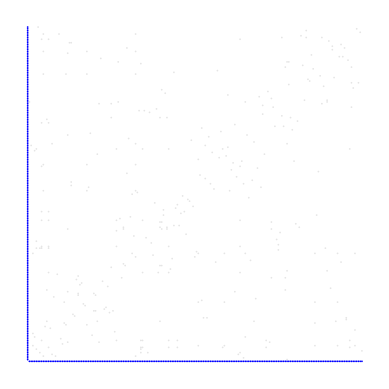

In [24]:
nv.MatrixPlot(t_131)
plt.show()

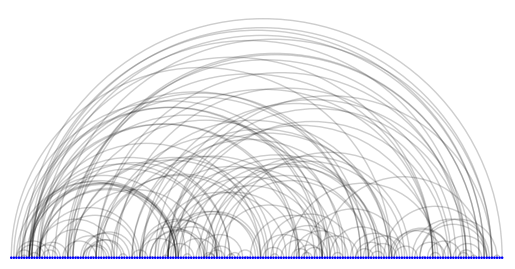

In [25]:
nv.ArcPlot(t_131)
plt.show()

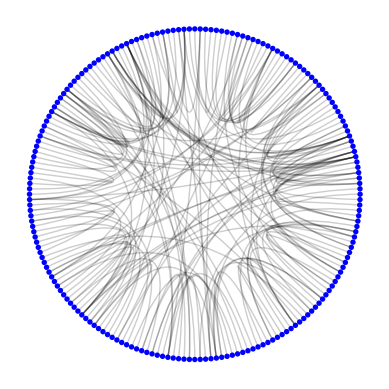

In [26]:
nv.CircosPlot(t_131)
plt.show()

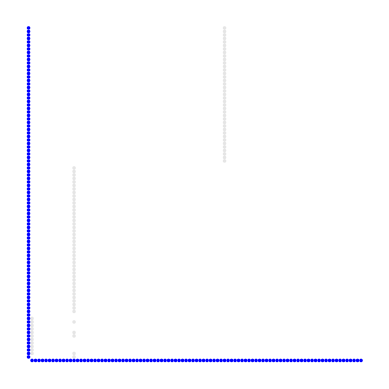

In [27]:
#Now the same but with the subset from twitter data.
nv.MatrixPlot(T_sub)
plt.show()

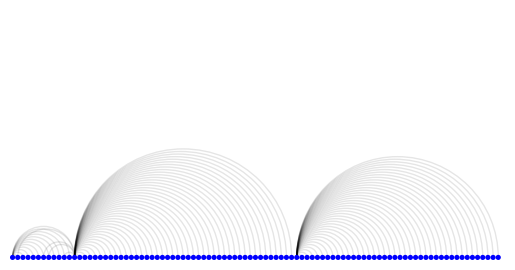

In [28]:
nv.ArcPlot(T_sub)
plt.show()

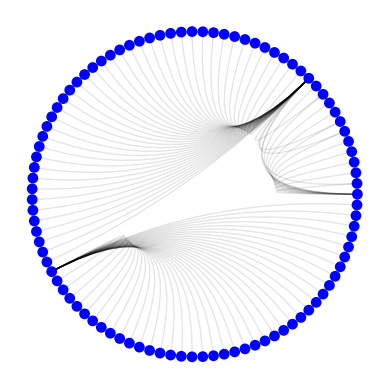

In [29]:
nv.CircosPlot(T_sub)
plt.show()

## Degree Centrality

How to determine which nodes are important 

- Which centre node might be more important?
  ![star_graph][1]

The centre node of the left graph is more important because it is connected to more nodes. Being connected to other nodes means other nodes are considered neighbours of that node. From the concept of neighbours, we can now introduce the concept of _degree centrality_

This is one of many metrics we can use to evaluate the importance of a node and is simply defined as the number of neighbours that a node has divided by the total number of neighbours that the node could possibly have:

> $\frac{\text{Number of Neighbors I Have}}{\text{Number of Neighbors I could Possibly Have}}$

Mathematically, the degree centrality $C_D(i)$of a node $i$ in an undirected graph is calculated as the ratio of the number of edges connected to node $i$ to the total number of nodes in the graph minus one: 

> $C_D(i) = \frac{\text{degree of node } i}{\text{total number of nodes} - 1}$

In a directed graph, there are two variants of degree centrality: in-degree centrality (counting incoming edges) and out-degree centrality (counting outgoing edges).

- There are two scenarios possible here:
  * if **self-loops are allowed**, such as in a network mapping of all bike trips in a bike-sharing system, then the number of neighbours that you could possibly have is every single node in the graph, including myself.
    
  * if **self-loops are not allowed**, such as in Twitter, where, by definition, your account cannot follow itself, then the number of neighbours you could possibly have is every other node in the graph, excluding myself.

- In the real world, the example of nodes in a graph that has a high degree of centrality might be:
  * Twitter broadcasters, that is, users that are followed by many other users
  * Airport transportation hubs, such as New York, London or Tokyo
  * Disease super-spreaders, who are the individuals that epidemiologists would want to track down to help stop the spread of a disease
   
  [1]: https://raw.githubusercontent.com/trenton3983/DataCamp/master/Images/2020-05-21_intro_to_network_analysis_in_python/star_graphs.JPG

Node 1: Degree Centrality = 0.750
Node 2: Degree Centrality = 0.500
Node 3: Degree Centrality = 0.750
Node 4: Degree Centrality = 0.500
Node 5: Degree Centrality = 0.500


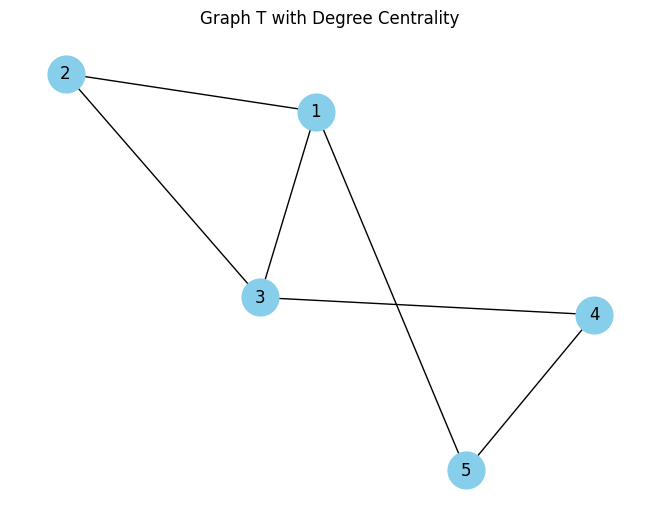

In [36]:
import networkx as nx
import matplotlib.pyplot as plt

# Synthetic graph
T = nx.Graph()
T.add_edges_from([(1, 2), (1, 3), (2, 3), (3, 4), (4, 5), (5, 1)])

# How to get the degree centrality
degree_centrality = nx.degree_centrality(T)

# Just a fancy plot for each node
for node, centrality in degree_centrality.items():
    print(f"Node {node}: Degree Centrality = {centrality:.3f}")

# Plot the graph
pos = nx.spring_layout(T)
nx.draw(T, pos, with_labels=True, node_size=700, node_color='skyblue')
plt.title('Graph T with Degree Centrality')
plt.show()


# Challenge 1

It's time for you to apply everything you learned by analyzing a case study of GitHub's collaborator network data.

- **Data**: `github_users.p` (avaliable in Moodle)

> This dataset is a GitHub user collaboration network. As you already know, GitHub is a social coding site where users can collaborate on code repositories. In this network, nodes are users, and edges indicate that two users are collaborators on at least one GitHub repository.

1. Read the GitHub network dataset.
2. Describe using the basic functions of the graph's size. Explore nodes and edges. Provide how many nodes and edges are present in the network
3. Calculate the **degree centrality** of the GitHub collaboration network G. Using the .values() method of the network (e.g. G), extract the degree centrality values and convert them into a list. Then, plot a histogram to visualize the distribution of node degrees in the network.
4. Make a subset of the initial network (e.g. Gh_sub), where you include at least five nodes and their corresponding edges. Experiment with multiple nodes so you have a graph with enough edges to work on.
5. Plot the subset graph created.
6. Now calculate another relevant measure of the network -- **betweenness centrality**. Plot the betweenness centrality distribution of the subset you created. Tip: Same steps from the previous step, but use `nx.betweenness_centrality()`
7. Plot the Matrix, Arc and Circos from the subset.

Now I am going to load in the GitHub network dataset from the folder in moodle. 

In [46]:
import pickle

with open('data/Lab5/network_analysis/github_users.p', 'rb') as f:
    Gh = pickle.load(f)
Gh

I am now going to look at basic functions of the graph, such as the number of nodes and edges and the attributes that can be associated with them 

In [32]:
print(len(Gh))
print(type(Gh.nodes())) # Tells you the type of `T.nodes()`
print(list(Gh.edges(data=True))[-1]) # Read the attributes associated with the last element of the edges list. 
print(list(Gh.nodes(data=True))[0]) # Read the attributes associated with the firts element of the node list.
print(type(list(Gh.edges(data=True))[-1][2])) # Wich type; therefore, you can see what you are reading.

56519
<class 'networkx.classes.reportviews.NodeView'>
('u10898', 'u10901', {})
('u1', {'bipartite': 'users'})
<class 'dict'>


It seems as though there are no attributes for what attributes are associated with the edges, however there is an attribute associated with nodes which is 'bipartite'

In [33]:
Gh.number_of_edges()

72900

In [45]:
Gh.number_of_nodes()

NameError: name 'Gh' is not defined

In this graph, there are 56,519 nodes and 72900 edges between nodes. 

In [35]:
#list(Gh.degree)
#list(Gh.adj)
#list(Gh.edges(data=True))
#list(Gh.nodes(data=True))

The above cell confirms that there are many different connections between nodes and edges, but there are no distinguishable charecteristecs to select nodes by as they all have the same attribute. Therefore I am going to select nodes and corresponding edges by nbunch rather than list comprehensions, however first I am going to work out the degree centrality. 

**Degree Centrality**

I am going to use the degree_centrality function in nx, and then make a list of the degree_centrality to values to find out how connected they are to other nodes. 

In [36]:
degree_centrality = nx.degree_centrality(Gh)
list(degree_centrality.values())

[0.00023001521639123818,
 1.76934781839414e-05,
 0.001857815209313847,
 3.53869563678828e-05,
 0.0,
 0.00253016738030362,
 0.000353869563678828,
 0.000973141300116777,
 0.0,
 3.53869563678828e-05,
 0.0005131108673343006,
 0.0,
 3.53869563678828e-05,
 0.0003361760854948866,
 0.0005838847800700662,
 0.0027778760748787996,
 0.003007891291270038,
 8.8467390919707e-05,
 0.0,
 0.0005484978237021834,
 0.000973141300116777,
 0.0,
 0.0,
 0.000353869563678828,
 1.76934781839414e-05,
 0.0,
 8.8467390919707e-05,
 0.0008138999964613044,
 0.0017516543402101986,
 0.0003007891291270038,
 0.0003715630418627694,
 0.0,
 0.0,
 0.0,
 0.0,
 3.53869563678828e-05,
 0.0003715630418627694,
 0.0013093173856116636,
 0.000353869563678828,
 1.76934781839414e-05,
 0.0004777239109664178,
 3.53869563678828e-05,
 1.76934781839414e-05,
 0.002211684772992675,
 8.8467390919707e-05,
 0.0004069499982306522,
 0.0006723521709897732,
 0.0013447043419795464,
 0.0005838847800700662,
 0.0,
 3.53869563678828e-05,
 0.00146855868926

Now I am going to plot a histogram to show the distribution of node degree connectivity in the graph.

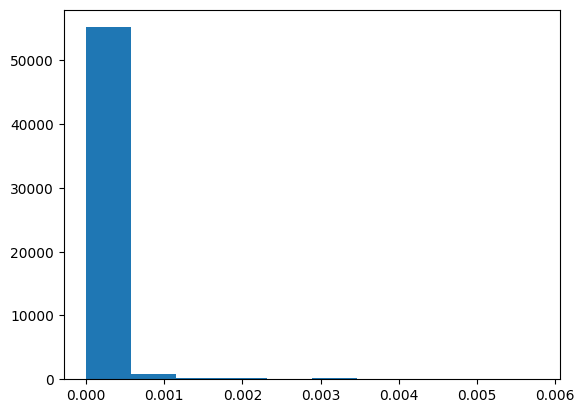

In [37]:
plt.hist(list(degree_centrality.values()))
plt.show()

The histogram above shows that most of the points are not important in terms of having a high number of degree centrality. In the case of git hub users it suggests that most users only interact with their own circle of other users and collaborate in smaller circles. However therea re a few counts where there are larger values of degree centrality, meaning that there are some GitHub accounts that many users collaborate with, these could be educational account or accounts that are the heads of large businesses with a lot of git hub users collaborating on that account.

Now I am going to make a subset of the initial network (e.g. Gh_sub), where you include at least five nodes and their corresponding edges. To do this I am going to use the command nbunch 

In [38]:
#edges from Gh - where the numbers specify the nodes i want to subset 
edges_from_Gh=Gh.edges(["u2","u6","u53","u18","u7"])
edges_from_Gh
#I am now going to make this list into a subset graph and see how many edges there are

EdgeDataView([('u2', 'u9346'), ('u6', 'u3'), ('u6', 'u5809'), ('u6', 'u2688'), ('u6', 'u5851'), ('u6', 'u5814'), ('u6', 'u1511'), ('u6', 'u719'), ('u6', 'u1866'), ('u6', 'u3681'), ('u6', 'u7940'), ('u6', 'u1560'), ('u6', 'u712'), ('u6', 'u1230'), ('u6', 'u958'), ('u6', 'u8059'), ('u6', 'u1764'), ('u6', 'u1873'), ('u6', 'u2024'), ('u6', 'u3855'), ('u6', 'u368'), ('u6', 'u5496'), ('u6', 'u3426'), ('u6', 'u204'), ('u6', 'u6701'), ('u6', 'u1260'), ('u6', 'u2160'), ('u6', 'u409'), ('u6', 'u1879'), ('u6', 'u72'), ('u6', 'u10243'), ('u6', 'u7195'), ('u6', 'u2823'), ('u6', 'u1608'), ('u6', 'u8480'), ('u6', 'u6980'), ('u6', 'u2593'), ('u6', 'u5207'), ('u6', 'u1937'), ('u6', 'u3467'), ('u6', 'u1842'), ('u6', 'u1054'), ('u6', 'u3610'), ('u6', 'u307'), ('u6', 'u6331'), ('u6', 'u7765'), ('u6', 'u1679'), ('u6', 'u8946'), ('u6', 'u5741'), ('u6', 'u1666'), ('u6', 'u784'), ('u6', 'u1350'), ('u6', 'u816'), ('u6', 'u7256'), ('u6', 'u2094'), ('u6', 'u1890'), ('u6', 'u6984'), ('u6', 'u1748'), ('u6', 'u115'

Creating an empty graph, which I can then assign the selected nodes and corresponding edges to.

In [39]:
Gh_sub = nx.DiGraph()
len(Gh_sub)

0

In [40]:
Gh_sub.add_edges_from(edges_from_Gh) #Adding the list from the subset of nodes.
len(Gh_sub)

225

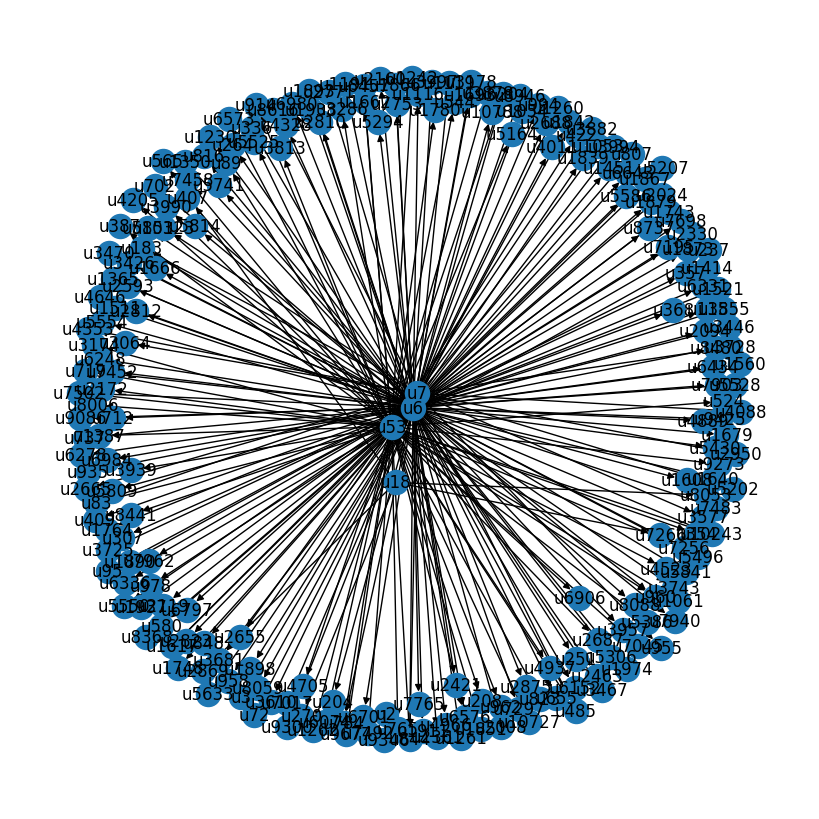

In [41]:
plt.figure(figsize=(8, 8))
nx.draw(Gh_sub, with_labels=True)
plt.show()

This graph is nice, because it shows there are some nodes which have many corresponding edges, such as u53, this suggests that u53, u7, u6 collaborate with a large number of other GitHub users, or u18, who only collaborate with a few other users, or u2, who only collaborate with one other user. 

**Betweeness centrality**

Plot the betweenness centrality distribution of the subset you created. Tip: Same steps from the previous step, but use `nx.betweenness_centrality()`

In [42]:
b_centrality = nx.betweenness_centrality(Gh_sub)
list(b_centrality.values())

[0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0011410954516335682,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0

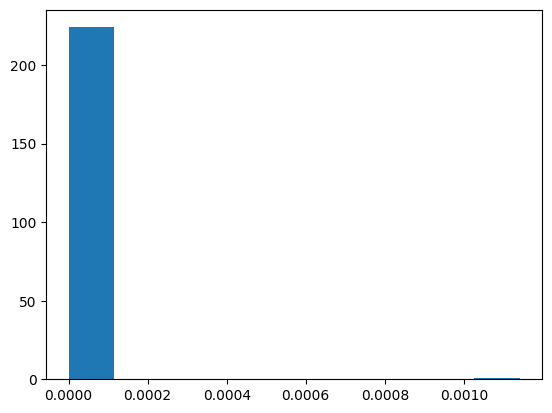

In [43]:
plt.hist(list(b_centrality.values()))
plt.show()

There is little that can be shown from this graph, this is becuause, there are a huge amount of github users and a lot of the time they collaborate with users from a small circle, therefore it was tricky to find a group of users where there was one key user whom many others collaborated. The histogram shows that there is one user who connects a couple of other users with the value of 0.0010

Plot the Matrix, Arc and Circos from the subset.

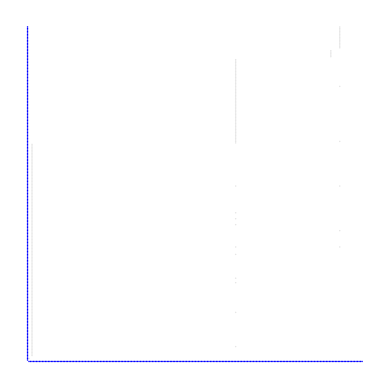

In [44]:
nv.MatrixPlot(Gh_sub)
plt.show()

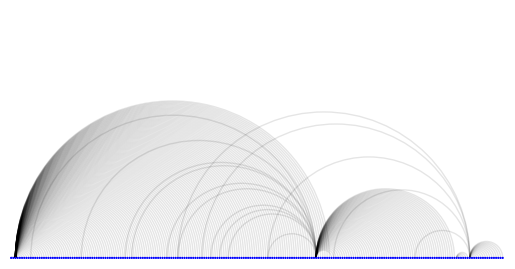

In [45]:
nv.ArcPlot(Gh_sub)
plt.show()

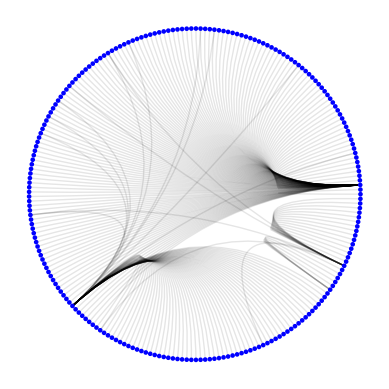

In [46]:
nv.CircosPlot(Gh_sub)
plt.show()

Thes plot shows that each node is connected to a variety of different nodes through the edges, it also shows that many of these nodes do not overlap (through the different vertical sections on the matrix plot), although it suggests that there are a some nodes which have edges between 2 or more other nodes (shown in both the arc plot and the circos plot with some edges going back to a node that has already been in the plot). 

# OSMnx

Is a Python package to download, model, analyze, and visualize street networks and other geospatial features from OpenStreetMap. You can download and model walking, driving, or biking networks with a single line of code then easily analyze and visualize them. You can just as easily work with urban amenities/points of interest, building footprints, transit stops, elevation data, street orientations, speed/travel time, and routing.[1]

[1]:https://geoffboeing.com/2016/11/osmnx-python-street-networks/

> The following practice are based on the OSMnx Examples Gallery[2]

[2]: https://github.com/gboeing/osmnx-examples/tree/main?tab=readme-ov-file#osmnx-examples-gallery

In [2]:
#pip install osmnx

In [49]:
#Install this package in case it is needed.

In [1]:
import networkx as nx
import osmnx as ox

## Fetch data from OSM

There are multiple ways to fetch the data from OSM, using osmnx

### Using a Place to Geocode

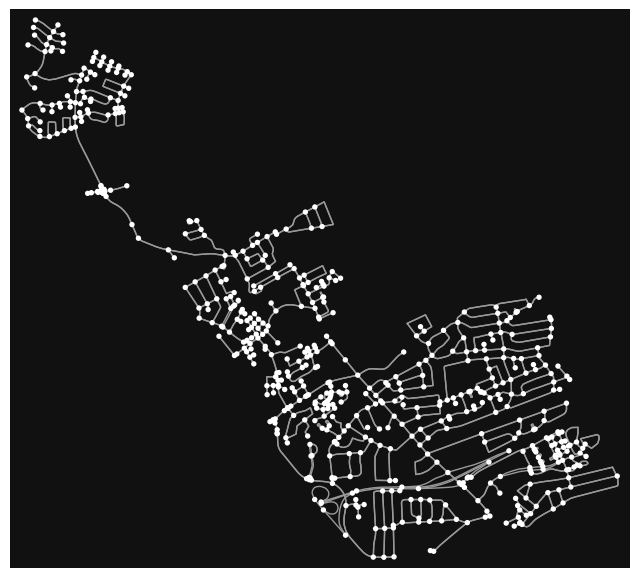

In [53]:
# download/model a street network for some city then visualize it
G = ox.graph_from_place("St Andrews", network_type="drive")
fig, ax = ox.plot_graph(G)

Here is the https://nominatim.openstreetmap.org/ui/search.html geocoding server we are using

### Making a query in a form of a Dict.

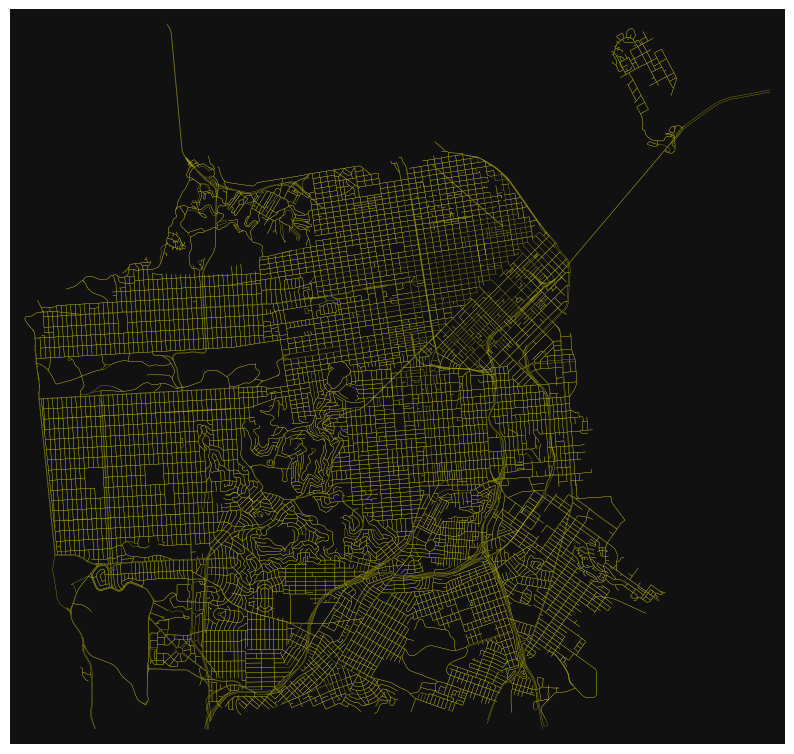

In [54]:
# You can make the query an unambiguous dict to help the geocoder find it
place = {"city": "San Francisco", "state": "California", "country": "USA"}
G = ox.graph_from_place(place, network_type="drive", truncate_by_edge=True)
fig, ax = ox.plot_graph(G, figsize=(10, 10), node_size=0, edge_color="y", edge_linewidth=0.2)

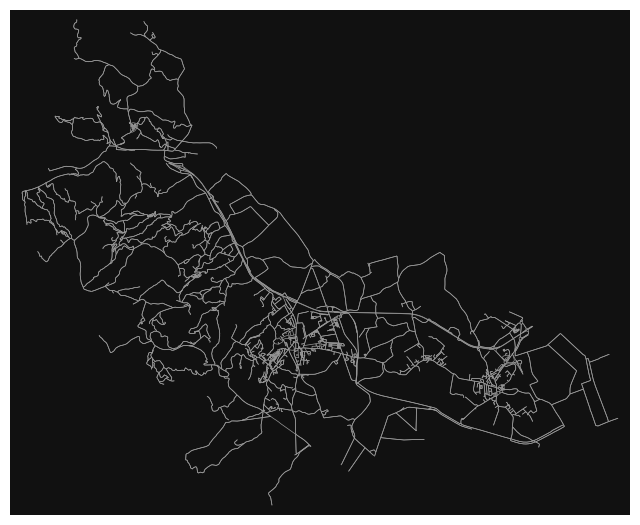

In [55]:
# You can get networks anywhere in the world
G = ox.graph_from_place("Sinalunga, Italy", network_type="all")
fig, ax = ox.plot_graph(G, node_size=0, edge_linewidth=0.5)

### Using a centre or BBox

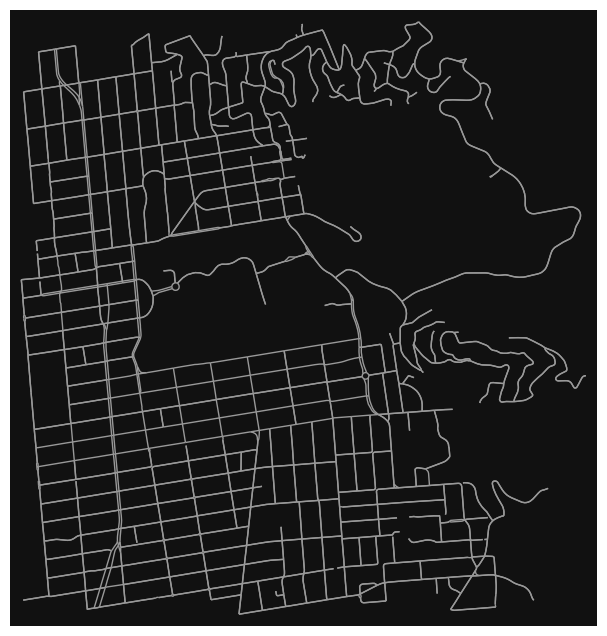

In [56]:
# or get network by address, coordinates, bounding box, or any custom polygon
# ...useful when OSM just doesn't already have a polygon for the place you want
wurster_hall = (37.870605, -122.254830)
one_mile = 1609  # meters
G = ox.graph_from_point(wurster_hall, dist=one_mile, network_type="drive")
fig, ax = ox.plot_graph(G, node_size=0)

### Fetch other type of features

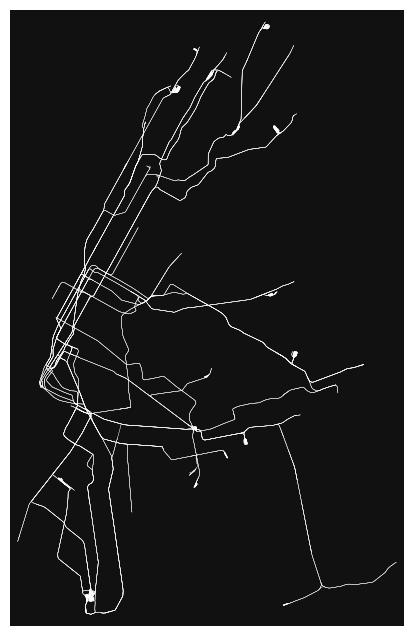

In [78]:
# get NY subway rail network
G = ox.graph_from_place(
    "New York, New York, USA",
    retain_all=False,
    truncate_by_edge=True,
    simplify=True,
    custom_filter='["railway"~"subway"]',
)

fig, ax = ox.plot_graph(G, node_size=0, edge_color="w", edge_linewidth=0.2)

the code above did not work, so after some research, i used geometries from place =, shown in the code below

In [72]:
place = "SoHo, New York, NY"
tags = {'building': True}
gdf = ox.geometries_from_place(place, tags=tags)
gdf.shape


(848, 87)

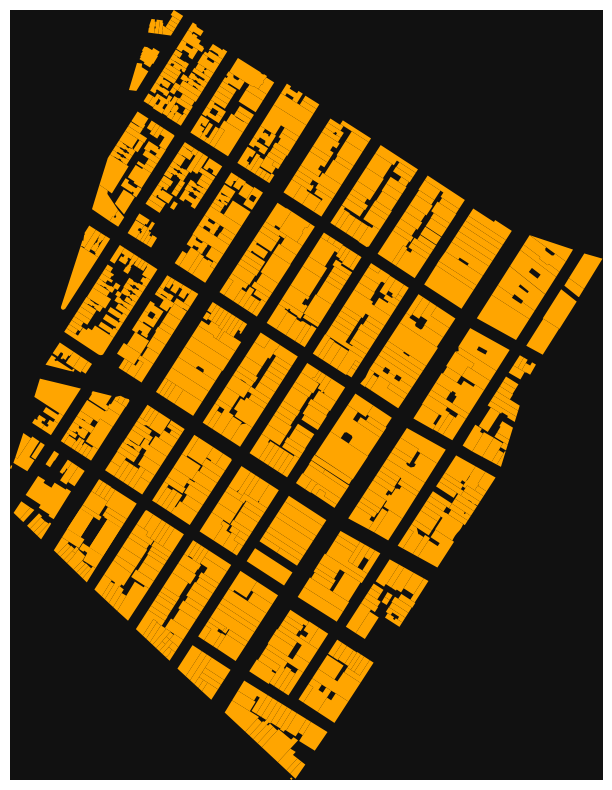

In [73]:
warnings.simplefilter('ignore', DeprecationWarning)

fig, ax = ox.plot_footprints(gdf, figsize=(12, 10))

> Now, try to find street network from other places or cities, for each method. 

My own street network searches are below: 

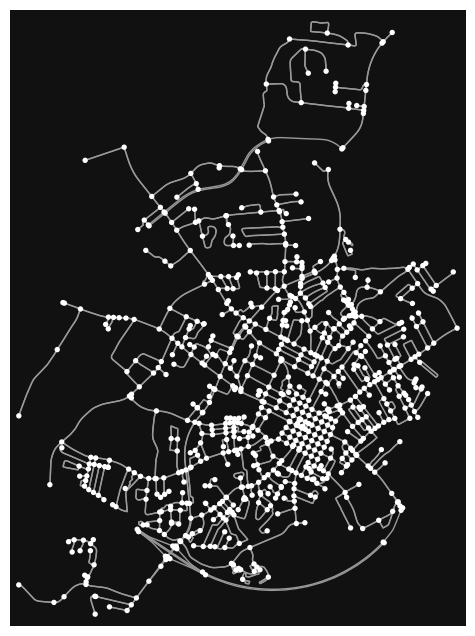

In [65]:
# download/model a street network for some city then visualize it
G = ox.graph_from_place("Glasgow", network_type="drive")
fig, ax = ox.plot_graph(G)

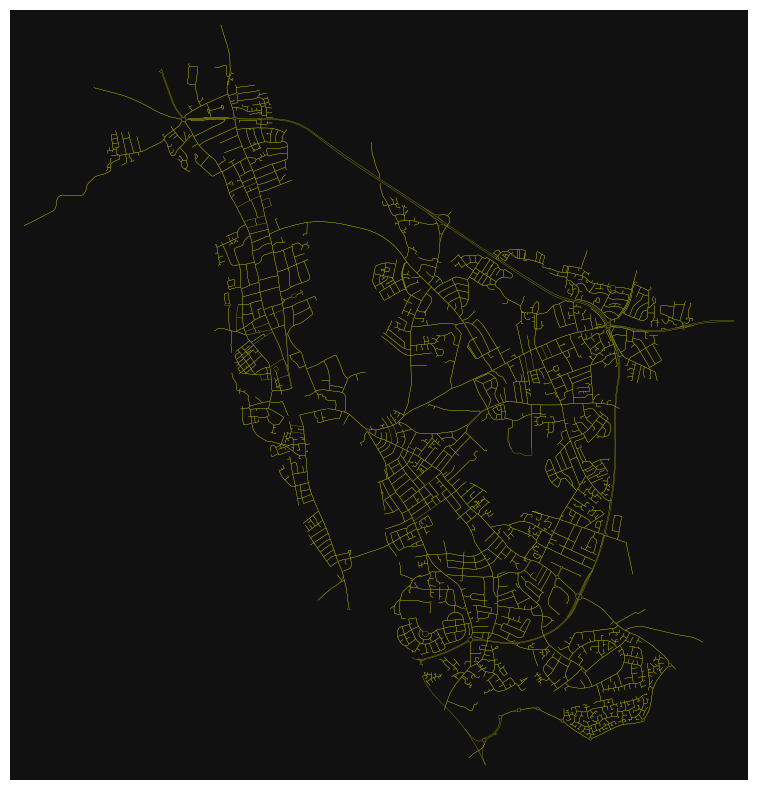

In [66]:
# You can make the query an unambiguous dict to help the geocoder find it
place = {"city": "Oxford", "country": "UK"}
G = ox.graph_from_place(place, network_type="drive", truncate_by_edge=True)
fig, ax = ox.plot_graph(G, figsize=(10, 10), node_size=0, edge_color="y", edge_linewidth=0.2)

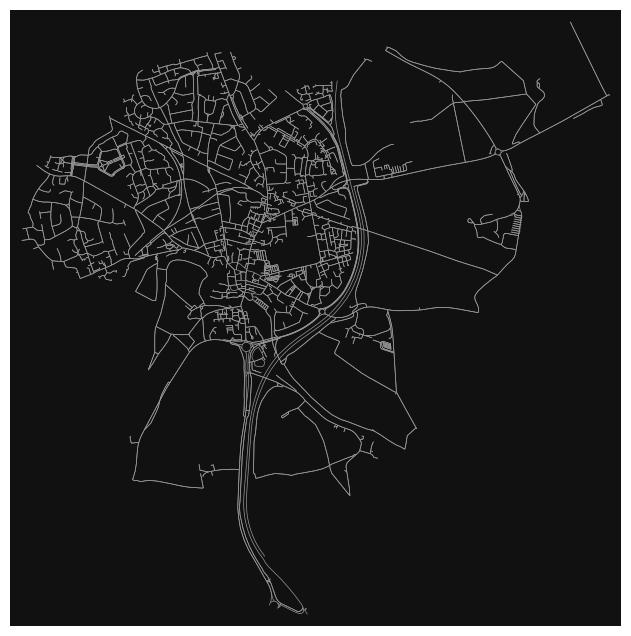

In [113]:
# You can get networks anywhere in the world
G = ox.graph_from_place("Wetherby, UK", network_type="all")
fig, ax = ox.plot_graph(G, node_size=0, edge_linewidth=0.5)

## Convert your MutiDiGraph to other formats or Graphs.


Probably the most common for you will be the GeoDataframes

In [114]:
warnings.simplefilter('ignore', DeprecationWarning)

# convert your MultiDiGraph to an undirected MultiGraph
M = ox.utils_graph.get_undirected(G)

# convert your MultiDiGraph to a DiGraph without parallel edges
D = ox.utils_graph.get_digraph(G)

# You can convert your graph to node and edge  GeoDataFrames
gdf_nodes, gdf_edges = ox.graph_to_gdfs(G)

In [117]:
gdf_nodes["highway"].unique()

array([nan, 'motorway_junction', 'mini_roundabout', 'crossing',
       'turning_circle', 'turning_loop'], dtype=object)

In [116]:
gdf_edges.head()
# Can you see the structure of this nested table?

osmid  oneway  \
u        v          key                                                       
1560066  1561164    0    [117884505, 117884531, 917127124, 3998262]    True   
13807360 1581228272 0                                     144582395    True   
26261632 2677105649 0                                     144587497   False   
         1581228174 0                                     144582403    True   
26261637 27464997   0                                       4482526   False   

                        lanes    ref    highway maxspeed reversed    length  \
u        v          key                                                       
1560066  1561164    0       3  A1(M)   motorway   70 mph    False  3798.457   
13807360 1581228272 0       2    NaN      trunk   40 mph    False    11.478   
26261632 2677105649 0       2   A661      trunk   30 mph    False    33.320   
         1581228174 0       2   A661      trunk   40 mph    False    31.205   
26261637 27464997   0       2  B6164  secondary   20 mph    False    29.638   

                        bridge  \
u        v          key          
1560066  1561164    0      yes   
13807360 1581228272 0      NaN   
26261632 2677105649 0      NaN   
         1581228174 0      NaN   
26261637 27464997   0      NaN   

                                                                  geometry  \
u        v          key                                                      
1560066  1561164    0    LINESTRING (-1.38377 53.90979, -1.38427 53.910...   
13807360 1581228272 0    LINESTRING (-1.38513 53.92346, -1.38516 53.923...   
26261632 2677105649 0    LINESTRING (-1.38568 53.92419, -1.38571 53.92449)   
         1581228174 0    LINESTRING (-1.38568 53.92419, -1.38564 53.924...   
26261637 27464997   0    LINESTRING (-1.38569 53.92758, -1.38568 53.92785)   

                           junction         name service access width tunnel  
u        v          key                                                       
1560066  1561164    0           NaN          NaN     NaN    NaN   NaN    NaN  
13807360 1581228272 0    roundabout          NaN     NaN    NaN   NaN    NaN  
26261632 2677105649 0           NaN  Boston Road     NaN    NaN   NaN    NaN  
         1581228174 0           NaN  Boston Road     NaN    NaN   NaN    NaN  
26261637 27464997   0           NaN  High Street     NaN    NaN   NaN    NaN

## Basic street network stats

In [82]:
# What sized area does our network cover in square meters?
warnings.filterwarnings('ignore')
G_proj = ox.project_graph(G)
nodes_proj = ox.graph_to_gdfs(G_proj, edges=False)
graph_area_m = nodes_proj.unary_union.convex_hull.area
graph_area_m

590567384.4887229

In [83]:
# show some basic stats about the network
ox.basic_stats(G_proj, area=graph_area_m, clean_int_tol=15)

{'n': 2992,
 'm': 7758,
 'k_avg': 5.185828877005347,
 'edge_length_total': 2712580.1700000023,
 'edge_length_avg': 349.64941608662053,
 'streets_per_node_avg': 2.5929144385026737,
 'streets_per_node_counts': {0: 0, 1: 700, 2: 0, 3: 2110, 4: 182},
 'streets_per_node_proportions': {0: 0.0,
  1: 0.2339572192513369,
  2: 0.0,
  3: 0.7052139037433155,
  4: 0.060828877005347594},
 'intersection_count': 2292,
 'street_length_total': 1356290.0850000046,
 'street_segment_count': 3879,
 'street_length_avg': 349.64941608662144,
 'circuity_avg': 1.053620522550638,
 'self_loop_proportion': 0.0,
 'clean_intersection_count': 535,
 'node_density_km': 5.066314325147316,
 'intersection_density_km': 3.8810135137826367,
 'edge_density_km': 4593.176394846776,
 'street_density_km': 2296.588197423394,
 'clean_intersection_density_km': 0.9059084772572908}

Check this link to get all the available stats you can get from a street network 
stats documentation: https://osmnx.readthedocs.io/en/stable/osmnx.html#module-osmnx.stats



## Visualize street centrality

Here we plot the street network and color its edges (streets) by their relative closeness centrality.

In [84]:
# convert graph to line graph so edges become nodes and vice versa
edge_centrality = nx.closeness_centrality(nx.line_graph(G))
nx.set_edge_attributes(G, edge_centrality, "edge_centrality")

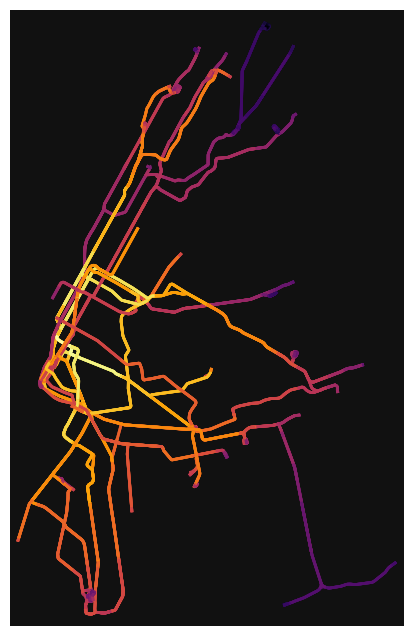

In [85]:
# color edges in original graph with closeness centralities from line graph
ec = ox.plot.get_edge_colors_by_attr(G, "edge_centrality", cmap="inferno")
fig, ax = ox.plot_graph(G, edge_color=ec, edge_linewidth=2, node_size=0)

## Routing

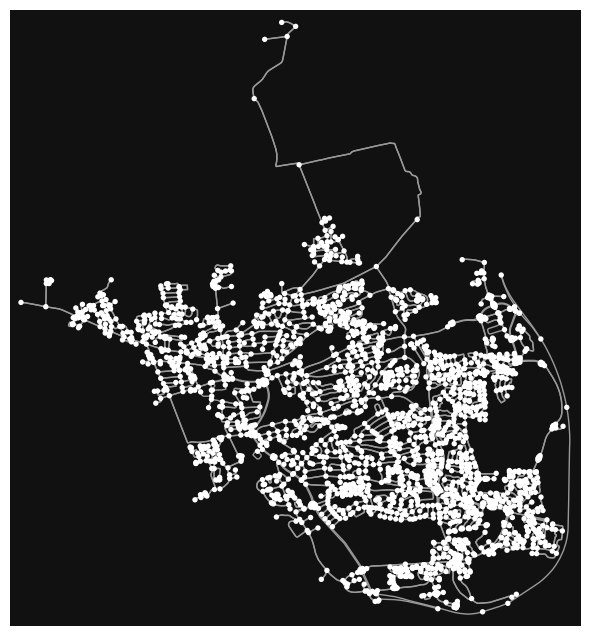

In [86]:
# impute missing edge speeds and calculate edge travel times with the speed module
G = ox.graph_from_place("Dunfermline, Scotland", network_type="drive")
fig, ax = ox.plot_graph(G)

G = ox.speed.add_edge_speeds(G)
G = ox.speed.add_edge_travel_times(G)

In [87]:
# get the nearest network nodes to two lat/lng points with the distance module
orig = ox.distance.nearest_nodes(G, X=-3.43071, Y=56.07775)
dest = ox.distance.nearest_nodes(G, X=-3.40972, Y=56.05672)

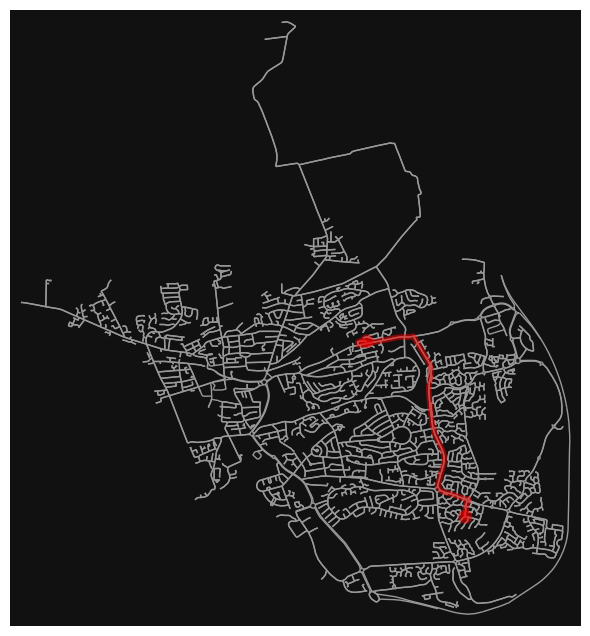

In [6]:

# find the shortest path between nodes, minimizing travel time, then plot it
route = ox.shortest_path(G, orig, dest, weight="travel_time")
fig, ax = ox.plot_graph_route(G, route, node_size=0)

In [88]:
# how long is our route in meters?
edge_lengths = ox.utils_graph.route_to_gdf(G, route)["length"]
round(sum(edge_lengths))

AttributeError: module 'osmnx.utils_graph' has no attribute 'route_to_gdf'

In [90]:
# how far is it between these two nodes as the crow flies?
# use OSMnx's vectorized great-circle distance (haversine) function
orig_x = G.nodes[orig]["x"]
orig_y = G.nodes[orig]["y"]
dest_x = G.nodes[dest]["x"]
dest_y = G.nodes[dest]["y"]
round(ox.distance.great_circle(orig_y, orig_x, dest_y, dest_x))

AttributeError: module 'osmnx.distance' has no attribute 'great_circle'

Your turn try to find another city and compute the nearest route. and the basic stats.

In [ ]:
#Add your code here.

### Add Elevation profile to routing

> You can add elevation attributes to your graph's nodes automatically with the elevation module, using either local raster files or the Google Maps Elevation API.

1. Go to https://developers.google.com/maps/documentation/elevation/get-api-key
2. Follow the instructions to get the google elevation api key. This is a paid service, but you can get a free trial where you can get an API key and complete this part. You don't need to restrict your API key as it would not be used in production env.
3. **NOTE:** DO NOT ADD ANY PAYMENT METHOD...this is an entirely academic exercise; if you don't have access to a Free Trial, then skip the next part. 

> This is probably new for you, but we can use the method `try/except` to control potential errors in our code. This is very useful to make our code more easy to digest. So you can add `try:`, then the code you would like to run, and if there is any problem, then add `except` to print or customize the error.
> 

In [ ]:
# Add elevation to nodes automatically, calculate edge grades, plot network
try:
    from keys import google_elevation_api_key
    G = ox.elevation.add_node_elevations_google(G, api_key=google_elevation_api_key) #replace your key here!
    G = ox.elevation.add_edge_grades(G)
    nc = ox.plot.get_node_colors_by_attr(G, "elevation", cmap="plasma")
    fig, ax = ox.plot_graph(G, node_color=nc, node_size=20, edge_linewidth=2, edge_color="#333")
except ImportError:
    print("You need a google_elevation_api_key to run this cell.")

Nodes are colored from lowest elevation (dark blue) to highest (bright yellow).

There is an example here (https://github.com/gboeing/osmnx-examples/blob/bb870c225906db5a7b02c4c87a28095cb9dceb30/notebooks/12-node-elevations-edge-grades.ipynb) of how to create the same outcome by using a local elevation model and creating elevation-based impedance functions to route around hills.

## Street network figure-ground diagrams
This is a cool feature from the OSMnx library you can plot a figure-ground figures from your favorites places.

In [8]:
import osmnx as ox
from IPython.display import Image

In [52]:
# configure the inline image display
img_folder = "images"
extension = "png"
size = 240
dpi = 40

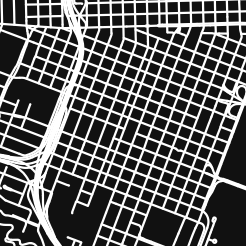

In [53]:
place = "portland"
point = (45.517309, -122.682138)
fp = f"./{img_folder}/{place}.{extension}"
fig, ax = ox.plot_figure_ground(
    point=point,
    network_type="drive",
    filepath=fp,
    dpi=dpi,
    save=True,
    show=False,
    close=True,
)
Image(fp, height=size, width=size)

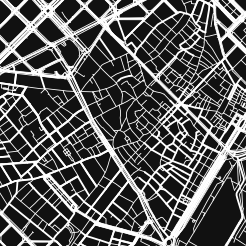

In [11]:
place = "barcelona-gothic"
point = (41.382850, 2.174192)
fp = f"./{img_folder}/{place}.{extension}"
fig, ax = ox.plot_figure_ground(
    point=point,
    network_type="all",
    default_width=3.3,
    filepath=fp,
    dpi=dpi,
    save=True,
    show=False,
    close=True,
)
Image(fp, height=size, width=size)

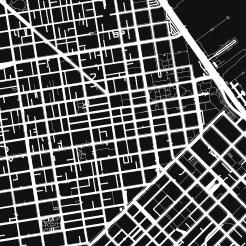

In [12]:
street_widths = {
    "footway": 0.5,
    "steps": 0.5,
    "pedestrian": 0.5,
    "path": 0.5,
    "track": 0.5,
    "service": 2,
    "residential": 3,
    "primary": 5,
    "motorway": 6,
}
place = "sf-custom"
point = (37.793897, -122.402189)
fp = f"./{img_folder}/{place}.{extension}"
fig, ax = ox.plot_figure_ground(
    point=point,
    filepath=fp,
    network_type="all",
    street_widths=street_widths,
    dpi=dpi,
    save=True,
    show=False,
    close=True,
)
Image(fp, height=size, width=size)

> Would you care the custome the previous figure-ground plots to add the name of the place at the top so you have a cool map?

## Explore urban networks as interactive web maps


In [67]:
warnings.filterwarnings('ignore')
# download a street network then solve a shortest-path route on it
weight = "length"
G = ox.graph_from_place("Candelaria, Bogota", network_type="drive")
orig = list(G.nodes)[0]
dest = list(G.nodes)[-1]
route = ox.shortest_path(G, orig, dest, weight=weight)

In [7]:
# explore graph edges interactively, with a simple one-liner
ox.graph_to_gdfs(G, nodes=False).explore()

In [8]:
# explore graph nodes interactively, with different basemap tiles
nodes = ox.graph_to_gdfs(G, edges=False)
nodes.explore(tiles="cartodbpositron", marker_kwds={"radius": 8})

In [9]:
# explore nodes and edges together in a single map
nodes, edges = ox.graph_to_gdfs(G)
m = edges.explore(color="skyblue", tiles="cartodbdarkmatter")
nodes.explore(m=m, color="pink", marker_kwds={"radius": 6})

In [10]:
# explore graph edges interactively, colored by length
edges.explore(tiles="cartodbdarkmatter", column="length", cmap="plasma")

In [11]:
# explore graph nodes interactively, colored by betweenness centrality
nx.set_node_attributes(G, nx.betweenness_centrality(G, weight="length"), name="bc")
nodes = ox.graph_to_gdfs(G, edges=False)
nodes.explore(tiles="cartodbdarkmatter", column="bc", marker_kwds={"radius": 8})

## Save/Export your network in another format.
It is very useful to use the graph in another GIS software or python library

In [12]:
# Save graph to disk as geopackage (for GIS) or graphml file (for gephi etc)
ox.save_graph_geopackage(G, filepath="./data/mynetwork.gpkg")
ox.save_graphml(G, filepath="./data/mynetwork.graphml")

# Challenge 2

This challenge is about OSMnx. You will explore and analyze a city's street network using the OSMnx Python library.

1. Use OSMnx to download the street network of a city of your choice. You can specify the city name, BBox or a Dict.
2. Calculate basic statistics for the street network, such as the number of nodes, edges, average node degree, etc.
3. Use OSMnx to plot the street network. Customize the plot to make it visually appealing, including node size, edge color. See the potential options here: https://osmnx.readthedocs.io/en/stable/user-reference.html#module-osmnx.plot
4. Utilize the routing capabilities of OSMnx to find the shortest path between two points in the street network. Plot the route on top of the street network.
5. Calculate the centrality measures (e.g., degree centrality and betweenness_centrality) for nodes in the street network.
6. Create the figure-groud from the selected city
7. Create interactive maps to plot nodes, edges, nodes+edges and one of the centrality measures.
8. Export the street network to a GeoPackage (.gpkg) file. Ensure that the exported file contains both node and edge attributes. Demonstrate that the new GeoPackage can be used and read in Python using any of the libraries we have seen in the class to create a simple and interactive map.
9. Finally, use OSMnx to extract other urban elements (e.g., buildings, parks) and plot them.

I am going to try and download data regardng Cambridge, in the UK and I am going to search for it using its city name:

However first I am going to install all of the necessary packages for this challenge

In [4]:
import warnings
warnings.simplefilter('ignore', DeprecationWarning)
warnings.filterwarnings('ignore')

import networkx as nx

import matplotlib.pyplot as plt

import osmnx as ox
from IPython.display import Image

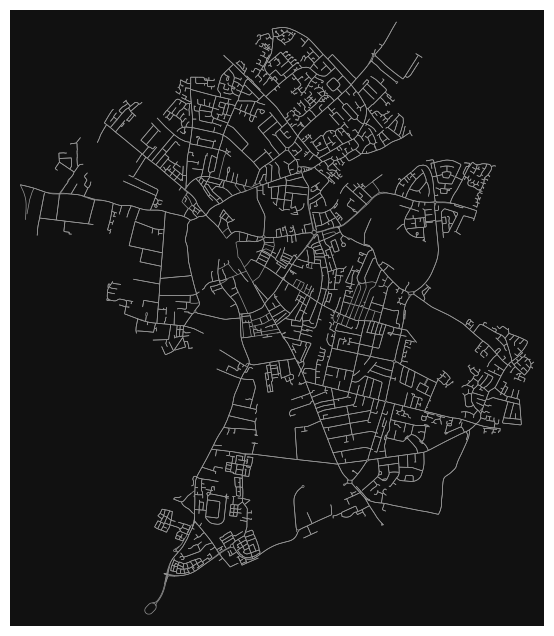

In [5]:
Cambs = ox.graph_from_place("Cambridge, UK", network_type="drive")

fig, ax = ox.plot_graph(Cambs, node_size=0, edge_linewidth=0.5)

Next, I am going to calculate basic statistics for the street network, such as the number of nodes, edges, average node degree, etc. To do this I will use many of the basic functions that we learnt in the first part of this lab.

In [6]:
type(Cambs)

networkx.classes.multidigraph.MultiDiGraph

In [7]:
Cambs.number_of_edges()

7168

In [8]:
Cambs.number_of_nodes()

3257

In this graph, there are 3257 nodes and 7168 edges between nodes. 

Therefore on average, there are 2.2 edges per node. (7168/3257)

In [9]:
#list(Cambs.degree)
#list(Cambs.edges(data=True))
#list(Cambs.nodes(data=True))

Metadata for edges: 
* 'osmid' - I am assuming the ID associated with OS maps
* 'name' - name of street
* 'highway'
* 'maxspeed'
* 'oneway' - boolean
* 'reversed' - boolean
* 'length'
* 'width'
* 'geometry
* 'bridge'

Metadata for nodes: 
* x
* y
* street_count
* highway

In [10]:
nx.degree_histogram(Cambs)

[0, 3, 1090, 178, 196, 101, 1585, 12, 92]

The code above shows that most of the nodes have a degree of 2 or 6. 

In [163]:
# What sized area does our network cover in square meters?
warnings.filterwarnings('ignore')
Cambs_proj = ox.project_graph(Cambs)
nodes_proj = ox.graph_to_gdfs(Cambs_proj, edges=False)
graph_area_m = nodes_proj.unary_union.convex_hull.area
graph_area_m

43525737.699311554

In [165]:
# show some basic stats about the network
ox.basic_stats(Cambs_proj, area=graph_area_m, clean_int_tol=15)

{'n': 3257,
 'm': 7168,
 'k_avg': 4.401596561252687,
 'edge_length_total': 622896.5829999989,
 'edge_length_avg': 86.89963490513378,
 'streets_per_node_avg': 2.36874424316856,
 'streets_per_node_counts': {0: 0, 1: 1081, 2: 47, 3: 1980, 4: 145, 5: 4},
 'streets_per_node_proportions': {0: 0.0,
  1: 0.33190052195271724,
  2: 0.014430457476205097,
  3: 0.6079214000614062,
  4: 0.04451949646914338,
  5: 0.0012281240405280934},
 'intersection_count': 2176,
 'street_length_total': 328142.047000001,
 'street_segment_count': 3838,
 'street_length_avg': 85.49818837936452,
 'circuity_avg': 1.0699476258376732,
 'self_loop_proportion': 0.006253256904637832,
 'clean_intersection_count': 1656,
 'node_density_km': 74.82928887961194,
 'intersection_density_km': 49.993408843118075,
 'edge_density_km': 14310.994274310744,
 'street_density_km': 7539.034703257682,
 'clean_intersection_density_km': 38.04645452399059}

3. Use OSMnx to plot the street network. Customize the plot to make it visually appealing, including node size, edge color. See the potential options here: https://osmnx.readthedocs.io/en/stable/user-reference.html#module-osmnx.plot

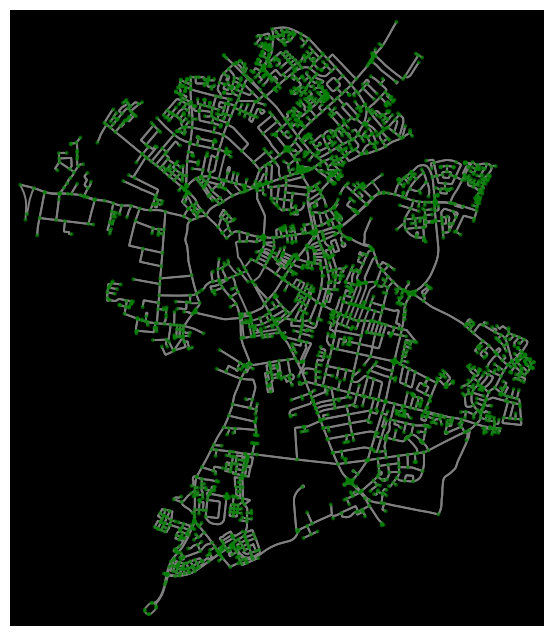

(<Figure size 800x800 with 1 Axes>, <Axes: >)

In [11]:
ox.plot.plot_graph(Cambs, ax=None, figsize=(8, 8), bgcolor='black', node_color='green', node_size=8, node_alpha=0.7, node_edgecolor='none', node_zorder=1,
                      edge_color='gray', edge_linewidth=1.4, edge_alpha=None, show=True)

4. Utilize the routing capabilities of OSMnx to find the shortest path between two points in the street network. Plot the route on top of the street network.

I am going to look at the different nodes of Cambridge with the data on, so that I can see the lats and longs of each node, from this, I will select two points to calculate that shortest distance route.  

In [13]:
#list(Cambs.nodes(data=True))

I am going to selected node #6550180 'y': 52.2345959, 'x': 0.1288634 as origin and node #20823806 'y': 52.2047042, 'x': 0.1323713 as destination. 

The following code cell assigns the nodes that are closest to these latitude longitude pairs. Since I had got the lat/longs directly from a node in the dataset, I tried to input them straight into the code that was actually calculating the shortest path, but it didnt work, I think maybe due to errors in rounding in the list code. Therefore I selected nodes that were closest to these longitudes and latitudes. THe following code calculates the shortest route, which is according to travel_time and plots it in red on the map. 

In [20]:
# get the nearest network nodes to two lat/lng points with the distance module
orig = ox.distance.nearest_nodes(Cambs, X=0.1288634, Y=52.2345959)
dest = ox.distance.nearest_nodes(Cambs, X=0.1323713, Y=52.2047042)

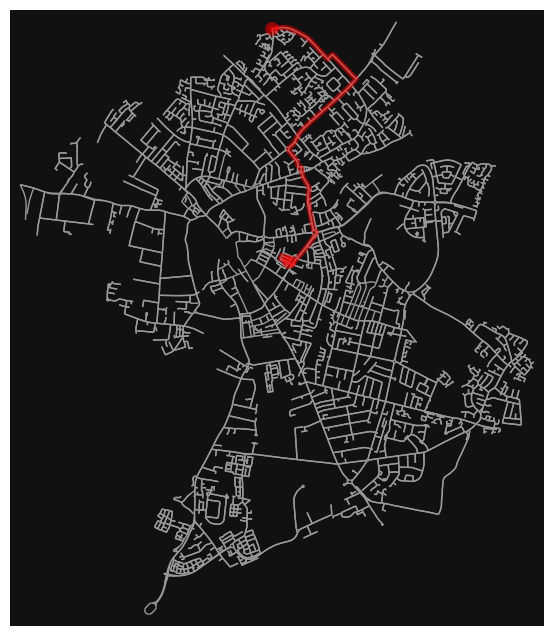

In [23]:
# find the shortest path between nodes, minimizing travel time, then plot it
route = ox.shortest_path(Cambs, orig, dest, weight="travel_time")
fig, ax = ox.plot_graph_route(Cambs, route, node_size=0)

5. Calculate the centrality measures (e.g., degree centrality and betweenness_centrality) for nodes in the street network.

In the following code, I am going to calculate the degree centrality and betweenness centrality for the nodes in the street network of Cambridge, I will then plot histograms to display the distrubution of these measures. Later in the challenge (q.7) I will map the betweeness centrality of the street network. 

**Degree Centrality:** 

In [24]:
degree_centrality = nx.degree_centrality(Cambs)

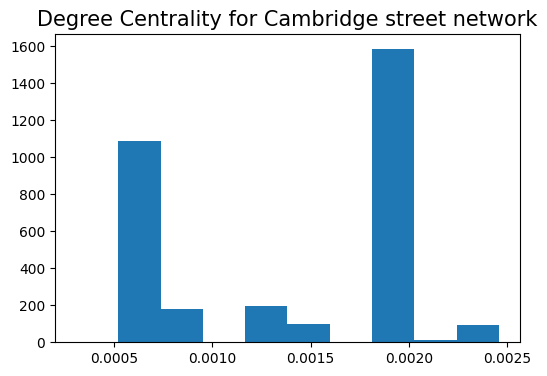

In [37]:
fig, ax = plt.subplots(figsize = (6,4))

plt.hist(list(degree_centrality.values()))
ax.set_title("Degree Centrality for Cambridge street network", size=15)

plt.show()

The degree centrality histogram shows that there is not a normal distribution of node degrees in the graph. There are some nodes connected to a large number of edges, shown by the high count of the bin just under 0.0020. However there are also a large number of nodes with very feew connected edges, shown by the smaller count of the bin with the lowest value. 

**Betweenness Centrality**

In [38]:
b_centrality = nx.betweenness_centrality(Cambs)

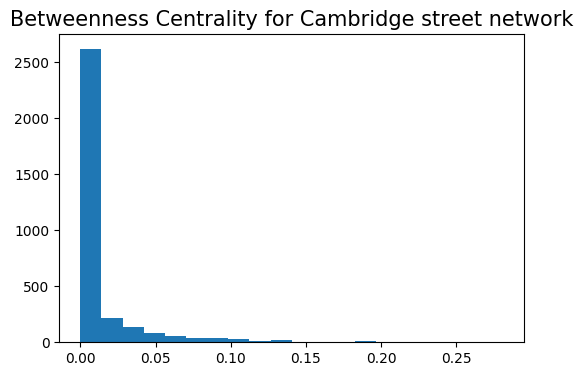

In [44]:
fig, ax = plt.subplots(figsize = (6,4))

plt.hist(b_centrality.values(), bins = 20)
ax.set_title("Betweenness Centrality for Cambridge street network", size=15)

plt.show()

The histogramf for betweeness centrality shows that there are a large number of nodes that are not in the centre of shortest path networks, and that there are few nodes which are highly connected to other nodes and play a part in connecting the nodes which are less connected. 



6. Create the figure-groud from the selected city

I have created a square-mile, figure-ground from Cambridge, including all network types to show walkways too, the roads are shown in thicker lines and then the residential walkways are thinner.

In [49]:
# configure the inline image display
img_folder = "images"
extension = "png"
size = 240
dpi = 40

In [135]:
#fig, ax = ox.plot_figure_ground(address=place, network_type = "all")

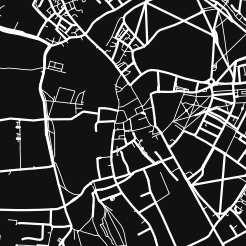

In [66]:
place = "Cambridge, UK"
fp = f"./{img_folder}/{place}.{extension}"
fig, ax = ox.plot_figure_ground(
    address=place,
    network_type="all",
    filepath=fp,
    dpi=dpi,
    save=True,
    show=False,
    close=True,
)
Image(fp, height=size, width=size)

7. Create interactive maps to plot nodes, edges, nodes+edges and one of the centrality measures.

In [68]:
# explore graph edges interactively, with a simple one-liner
ox.graph_to_gdfs(Cambs, nodes=False).explore()

In [72]:
# explore graph nodes interactively, with different basemap tiles
nodes = ox.graph_to_gdfs(Cambs, edges=False)
nodes.explore(tiles="cartodbpositron", marker_kwds={"radius": 2}, color='purple')

In [74]:
# explore nodes and edges together in a single map
nodes, edges = ox.graph_to_gdfs(Cambs)
m = edges.explore(color="skyblue", tiles="cartodbdarkmatter")
nodes.explore(m=m, color="pink", marker_kwds={"radius": 0.5})

In [76]:
# explore graph nodes interactively, colored by betweenness centrality
nx.set_node_attributes(Cambs, nx.betweenness_centrality(Cambs, weight="length"), name="bc")
nodes = ox.graph_to_gdfs(Cambs, edges=False)
nodes.explore(tiles="cartodbdarkmatter", column="bc", marker_kwds={"radius": 0.75})

8. Export the street network to a GeoPackage (.gpkg) file. Ensure that the exported file contains both node and edge attributes. Demonstrate that the new GeoPackage can be used and read in Python using any of the libraries we have seen in the class to create a simple and interactive map.


this one is not finished yet: using links
* https://osmnx.readthedocs.io/en/stable/user-reference.html#osmnx.io.save_graph_geopackage
* https://github.com/gboeing/osmnx/issues/411
* https://geonetworkx.readthedocs.io/en/latest/reference/readwrite.html
*  [Google Search](https://www.google.com/search?q=how+to+export+graph+as+a+geopackage+with+node+and+edge+attributes&rlz=1C1ZKTG_enGB895GB895&oq=how+to+export+graph+as+a+geopackage+with+node+and+edge+attributes&gs_lcrp=EgZjaHJvbWUyBggAEEUYOdIBCTEwODIwajBqNKgCALACAA&sourceid=chrome&ie=UTF-8)

* I think i might have to make nodes and edges files then bind them 

In [92]:
Cambs2 = ox.graph_from_place("Cambridge, UK", network_type="drive")
nodes, edges = ox.graph_to_gdfs(Cambs2)
Cambs2

In [110]:
ox.io.save_graph_geopackage(Cambs, filepath="./data/Lab5/Cambs_network.gpkg", encoding='utf-8', directed=False)

In [106]:
#saving the graph as a geopackage
ox.save_graph_geopackage(Cambs2, filepath="./data/Lab5/Cambs_network.gpkg", directed=True, node_attrs=nodes, edges=edges)

TypeError: save_graph_geopackage() got an unexpected keyword argument 'node_attrs'

Reading the geopackage into python using geopandas and creating an interactive map using one of the attributes

In [111]:
import geopandas as gpd

gdf = gpd.read_file("data/Lab5/Cambs_network.gpkg")
gdf.head()

,osmid,y,x,highway,street_count,bc,ref,geometry
0,104521,52.203550,0.123491,traffic_signals,3,0.035695,,POINT (0.12349 52.20355)
1,104522,52.204039,0.123043,,3,0.028852,,POINT (0.12304 52.20404)
2,104527,52.208411,0.118507,,2,0.038510,,POINT (0.11851 52.20841)
3,104534,52.207360,0.123521,,3,0.000511,,POINT (0.12352 52.20736)
4,104541,52.209201,0.117556,mini_roundabout,3,0.068761,,POINT (0.11756 52.20920)


9. Finally, use OSMnx to extract other urban elements (e.g., buildings, parks) and plot them.

First, I am going to plot the footprints of the buildings, and then I will try and plot some attribute, such as the parks. 

In [125]:
place = "Cambridge, UK"
tags = {'building': True}
gdf = ox.geometries_from_place(place, tags=tags)
gdf.shape


(34281, 343)

In [127]:
gdf.head()

historic                                        name  \
element_type osmid                                                             
node         1317828228      NaN                             Kelsey Kerridge   
             1345484518      NaN  Combination Room (University of Cambridge)   
             1425102785      NaN                                    Chopstix   
             1506615822      NaN                                         NaN   
             1506615880      NaN                                         NaN   

                                         geometry    amenity     ref entrance  \
element_type osmid                                                              
node         1317828228  POINT (0.13022 52.20103)        NaN     NaN      NaN   
             1345484518  POINT (0.11694 52.20541)        NaN  A011.4      NaN   
             1425102785  POINT (0.11942 52.20593)  fast_food     NaN      NaN   
             1506615822  POINT (0.14851 52.21236)        NaN     NaN      NaN   
             1506615880  POINT (0.14857 52.21236)        NaN     NaN      NaN   

                                        operator     brand brand:wikidata  \
element_type osmid                                                          
node         1317828228                      NaN       NaN            NaN   
             1345484518  University of Cambridge       NaN            NaN   
             1425102785                      NaN  Chopstix     Q115327253   
             1506615822                      NaN       NaN            NaN   
             1506615880                      NaN       NaN            NaN   

                        brand:wikipedia  ... construction building:part  \
element_type osmid                       ...                              
node         1317828228             NaN  ...          NaN           NaN   
             1345484518             NaN  ...          NaN           NaN   
             1425102785             NaN  ...          NaN           NaN   
             1506615822             NaN  ...          NaN           NaN   
             1506615880             NaN  ...          NaN           NaN   

                        residential service_times source:listed_status  \
element_type osmid                                                       
node         1317828228         NaN           NaN                  NaN   
             1345484518         NaN           NaN                  NaN   
             1425102785         NaN           NaN                  NaN   
             1506615822         NaN           NaN                  NaN   
             1506615880         NaN           NaN                  NaN   

                        start_date:listed_status type building:level  \
element_type osmid                                                     
node         1317828228                      NaN  NaN            NaN   
             1345484518                      NaN  NaN            NaN   
             1425102785                      NaN  NaN            NaN   
             1506615822                      NaN  NaN            NaN   
             1506615880                      NaN  NaN            NaN   

                        temporary ways  
element_type osmid                      
node         1317828228       NaN  NaN  
             1345484518       NaN  NaN  
             1425102785       NaN  NaN  
             1506615822       NaN  NaN  
             1506615880       NaN  NaN  

[5 rows x 343 columns]

In [138]:
warnings.simplefilter('ignore', DeprecationWarning)

fig, ax = ox.plot_footprints(gdf, figsize=(12, 10))

The plot above nicely shows the building footprints, the gdf table also shows that there are certain amenities, so I am going to further look into the different types of amenities and plot something else. 

In [137]:
gdf["amenity"].unique()

array([nan, 'fast_food', 'doctors', 'cafe', 'parking', 'library',
       'place_of_worship', 'bicycle_parking', 'adult_education_centre',
       'nursing_home', 'arts_centre', 'mixed-use centre', 'bus_station',
       'toilets', 'pub', 'pharmacy', 'dentist', 'police', 'courthouse',
       'social_facility', 'kindergarten', 'college', 'community_centre',
       'bank', 'clinic', 'hall', 'university', 'scout_hut',
       'language_school', 'post_office', 'fuel', 'studio', 'hospice',
       'restaurant', 'advice', 'bar', 'fire_station', 'car_rental',
       'post_depot', 'veterinary', 'theatre', 'school', 'boat_rental',
       'social_club', 'bbq', 'dressing_room', 'nightclub', 'car_wash',
       'shelter', 'trolley_bay'], dtype=object)

Going to try and plot the post_office and see if I can plot it over the other map 

In [154]:
gdf_pub = gdf[gdf["amenity"] == "pub"]

In [155]:
gdf_pub.head()

historic             name  \
element_type osmid                                
way          37800469      NaN  The Petersfield   
             45827856      NaN      The Maypole   
             49810020      NaN       Robin Hood   
             50928339      NaN         The Alex   
             52115600      NaN     Dobblers Inn   

                                                                geometry  \
element_type osmid                                                         
way          37800469  POLYGON ((0.14083 52.20128, 0.14072 52.20128, ...   
             45827856  POLYGON ((0.11910 52.20969, 0.11909 52.20967, ...   
             49810020  POLYGON ((0.17239 52.18398, 0.17217 52.18414, ...   
             50928339  POLYGON ((0.13920 52.20391, 0.13950 52.20395, ...   
             52115600  POLYGON ((0.13992 52.20539, 0.13990 52.20544, ...   

                      amenity  ref entrance     operator        brand  \
element_type osmid                                                      
way          37800469     pub  NaN      NaN          NaN          NaN   
             45827856     pub  NaN      NaN          NaN          NaN   
             49810020     pub  NaN      NaN  Greene King  Greene King   
             50928339     pub  NaN      NaN  Greene King          NaN   
             52115600     pub  NaN      NaN          NaN          NaN   

                      brand:wikidata brand:wikipedia  ... construction  \
element_type osmid                                    ...                
way          37800469            NaN             NaN  ...          NaN   
             45827856            NaN             NaN  ...          NaN   
             49810020       Q5564162             NaN  ...          NaN   
             50928339            NaN             NaN  ...          NaN   
             52115600            NaN             NaN  ...          NaN   

                      building:part residential service_times  \
element_type osmid                                              
way          37800469           NaN         NaN           NaN   
             45827856           NaN         NaN           NaN   
             49810020           NaN         NaN           NaN   
             50928339           NaN         NaN           NaN   
             52115600           NaN         NaN           NaN   

                      source:listed_status start_date:listed_status type  \
element_type osmid                                                         
way          37800469                  NaN                      NaN  NaN   
             45827856                  NaN                      NaN  NaN   
             49810020                  NaN                      NaN  NaN   
             50928339                  NaN                      NaN  NaN   
             52115600                  NaN                      NaN  NaN   

                      building:level temporary ways  
element_type osmid                                   
way          37800469            NaN       NaN  NaN  
             45827856            NaN       NaN  NaN  
             49810020            NaN       NaN  NaN  
             50928339            NaN       NaN  NaN  
             52115600            NaN       NaN  NaN  

[5 rows x 343 columns]

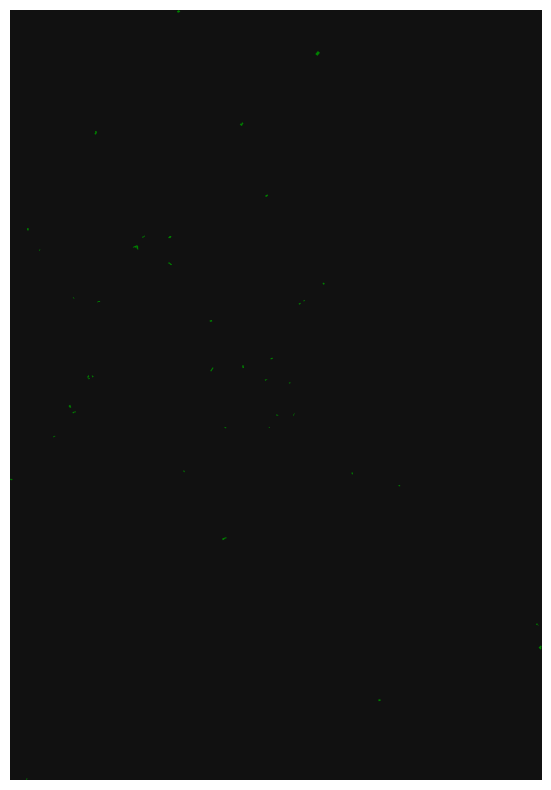

In [156]:
warnings.simplefilter('ignore', DeprecationWarning)
fig, ax = ox.plot_footprints(gdf_pub, figsize=(12, 10), color="green")

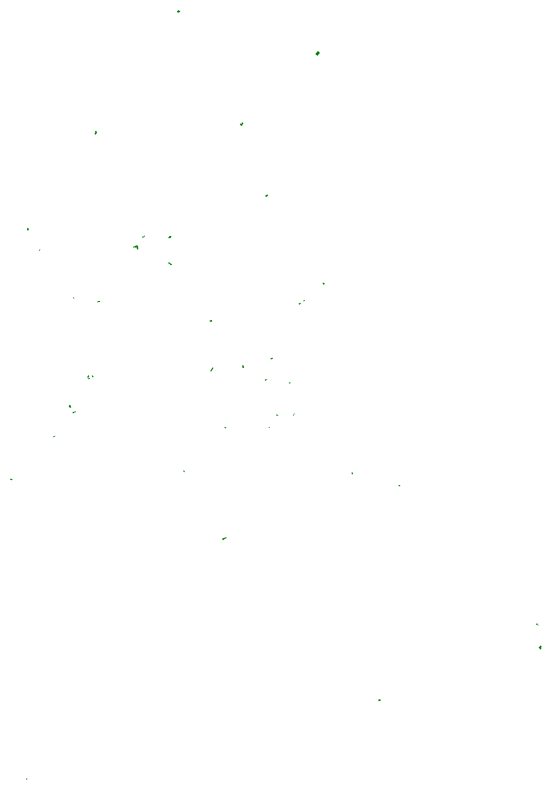

<Figure size 640x480 with 0 Axes>

In [160]:
fig, ax = plt.subplots(figsize=(12, 10))

# Plot the first GeoDataFrame on the axes
ox.plot_footprints(gdf_pub, color="green", ax=ax)

# Plot the second GeoDataFrame on the same axes
ox.plot_footprints(gdf, ax=ax)

# Show the plot
plt.show()

Mapping the parks in Cambridge

In [129]:
# get all the parks in some neighborhood
# constrain acceptable `leisure` tag values to `park`
tags = {"leisure": "park"}
gdf_park = ox.geometries_from_place(place, tags)
gdf_park.shape

(167, 29)

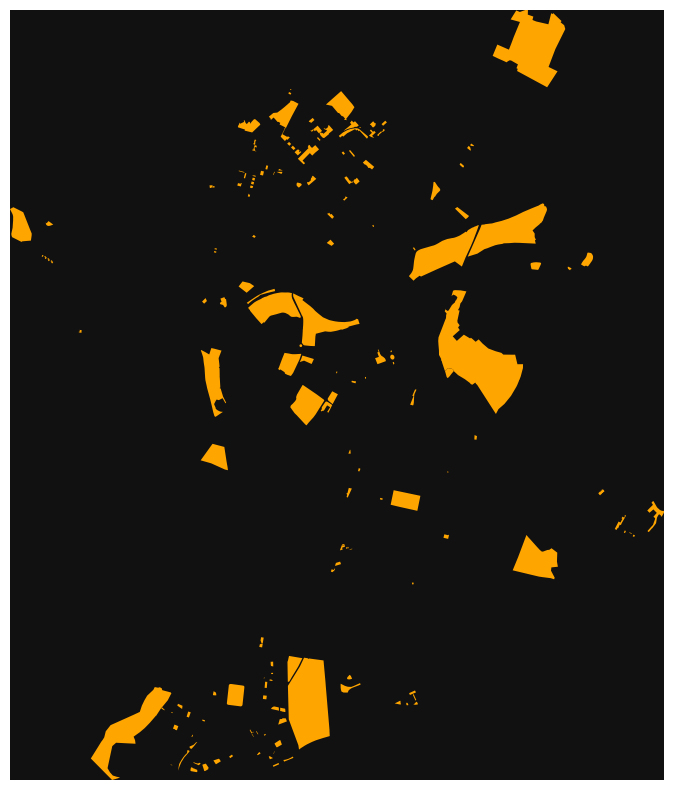

In [131]:
warnings.simplefilter('ignore', DeprecationWarning)

fig, ax = ox.plot_footprints(gdf_park, figsize=(12, 10))

# Networks Data source

https://snap.stanford.edu/data/

# Finishing the Lab

Please ensure that you save all your code and upload the latest version of this notebook to your **GitHub repository**. 

> Always check the size of your notebook before making any commit; use the `.gitignore` to skip big data sets or undesired files., but describe where to find the data and the correct structure, so when the marker forks, your code will be able to reproduce your results. 


# More resources

* https://en.wikipedia.org/wiki/Network_theory
* OSMnx Examples Gallery - https://github.com/gboeing/osmnx-examples
* https://networkx.org/documentation/latest/index.html
* https://nxviz.readthedocs.io/en/latest/index.html